In [1]:
%matplotlib inline
%load_ext autoreload
%autoreload 2
import tensorflow as tf
import numpy as np
import math
import matplotlib
#matplotlib.use("Agg")
import matplotlib.image as mpimg
import matplotlib.gridspec as gridspec
import glob
from data_utils import load_data, augment_data,normalise_train,normalise_test,rgb2gray,rgb2lab,lab2rgb
import matplotlib.pyplot as plt
from tucha import complex_pokemon_model,baselinish,simpler_model,baselinish2,complex_pokemon_model2,baselinish3

from cs231n.data_utils import load_CIFAR10

In [2]:
def show_images(images):
    images = np.reshape(images, [images.shape[0], -1,3])
    sqrtn = int(np.ceil(np.sqrt(images.shape[0])))
    sqrtimg = int(np.ceil(np.sqrt(images.shape[1])))

    fig = plt.figure(figsize=(sqrtn, sqrtn))
    gs = gridspec.GridSpec(sqrtn, sqrtn)
    gs.update(wspace=0.05, hspace=0.05)

    for i, img in enumerate(images):
        ax = plt.subplot(gs[i])
        plt.axis('off')
        ax.set_xticklabels([])
        ax.set_yticklabels([])
        ax.set_aspect('equal')
        plt.imshow(img.reshape([sqrtimg,sqrtimg,3]))
    return

In [3]:
def show_images2(images):
    images = np.reshape(images, [images.shape[0], -1])
    sqrtn = int(np.ceil(np.sqrt(images.shape[0])))
    sqrtimg = int(np.ceil(np.sqrt(images.shape[1])))

    fig = plt.figure(figsize=(sqrtn, sqrtn))
    gs = gridspec.GridSpec(sqrtn, sqrtn)
    gs.update(wspace=0.05, hspace=0.05)

    for i, img in enumerate(images):
        ax = plt.subplot(gs[i])
        plt.axis('off')
        ax.set_xticklabels([])
        ax.set_yticklabels([])
        ax.set_aspect('equal')
        plt.imshow(img.reshape([sqrtimg,sqrtimg]),cmap = plt.get_cmap('gray'))
    return

Training data shape:  (50000, 32, 32, 3)
Test data shape:  (10000, 32, 32, 3)


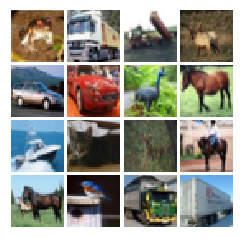

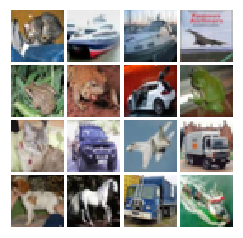

In [4]:
# Load the raw CIFAR-10 data.
from skimage import img_as_float
cifar10_dir = 'cs231n/datasets/cifar-10-batches-py'
X_train, y_train, X_test, y_test = load_CIFAR10(cifar10_dir)

# As a sanity check, we print out the size of the training and test data.
print('Training data shape: ', X_train.shape)
print('Test data shape: ', X_test.shape)
X_train = img_as_float(X_train.astype('uint8'))
X_test = img_as_float(X_test.astype('uint8'))
X_train = X_train.astype('float32')
X_test = X_test.astype('float32')
show_images(X_train[:16])
show_images(X_test[:16])

In [5]:
def leaky_relu(x, alpha=0.01):
    """Compute the leaky ReLU activation function.
    
    Inputs:
    - x: TensorFlow Tensor with arbitrary shape
    - alpha: leak parameter for leaky ReLU
    
    Returns:
    TensorFlow Tensor with the same shape as x
    """
    # TODO: implement leaky ReLU
    return tf.maximum(alpha*x,x)

In [6]:
def get_solvers(learning_rate=1e-3, beta1=0.5):
    """Create solvers for GAN training.
    
    Inputs:
    - learning_rate: learning rate to use for both solvers
    - beta1: beta1 parameter for both solvers (first moment decay)
    
    Returns:
    - D_solver: instance of tf.train.AdamOptimizer with correct learning_rate and beta1
    - G_solver: instance of tf.train.AdamOptimizer with correct learning_rate and beta1
    """
    D_solver = None
    G_solver = None
    D_solver = tf.train.AdamOptimizer(learning_rate = learning_rate,beta1 = beta1)
    G_solver = tf.train.AdamOptimizer(learning_rate = learning_rate,beta1 = beta1)
    return D_solver, G_solver

In [7]:
def gan_loss(logits_real, logits_fake):
    """Compute the GAN loss.
    
    Inputs:
    - logits_real: Tensor, shape [batch_size, 1], output of discriminator
        Log probability that the image is real for each real image
    - logits_fake: Tensor, shape[batch_size, 1], output of discriminator
        Log probability that the image is real for each fake image
    
    Returns:
    - D_loss: discriminator loss scalar
    - G_loss: generator loss scalar
    """
    # TODO: compute D_loss and G_loss
    D_loss = None
    G_loss = None
    label_one = tf.ones_like(logits_fake)
    label_zero = tf.zeros_like(logits_fake)
    G_loss = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits = logits_fake,labels = label_one))
    D_loss = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits = logits_real,labels = label_one) + \
             tf.nn.sigmoid_cross_entropy_with_logits(logits = logits_fake,labels = label_zero) )  
    return D_loss, G_loss

In [8]:
def lsgan_loss(score_real, score_fake):
    """Compute the Least Squares GAN loss.
    
    Inputs:
    - score_real: Tensor, shape [batch_size, 1], output of discriminator
        score for each real image
    - score_fake: Tensor, shape[batch_size, 1], output of discriminator
        score for each fake image    
          
    Returns:
    - D_loss: discriminator loss scalar
    - G_loss: generator loss scalar
    """
    # TODO: compute D_loss and G_loss
    D_loss = None
    G_loss = None
    G_loss = 0.5*tf.reduce_mean(tf.square(score_fake-1))
    D_loss = 0.5*tf.reduce_mean(tf.square(score_real-1) + tf.square(score_fake))
    return D_loss, G_loss

In [9]:
def discriminator(x):
    """Compute discriminator score for a batch of input images.
    
    Inputs:
    - x: TensorFlow Tensor of flattened input images, shape [batch_size, 784]
    
    Returns:
    TensorFlow Tensor with shape [batch_size, 1], containing the score 
    for an image being real for each input image.
    """
    with tf.variable_scope("discriminator"):
        # TODO: implement architecture
        #reshaped_x = tf.transpose(x,perm = [0,2,3,1])
        reshaped_x = x
        a1 = tf.layers.conv2d(reshaped_x,filters = 32,kernel_size = [5,5],activation = leaky_relu,padding = 'same')
        a1 = tf.layers.batch_normalization(a1,training = True)
        a1 = tf.layers.max_pooling2d(a1,pool_size = [2,2],strides = [2,2])
        a1 = tf.layers.conv2d(a1,filters = 64,kernel_size = [5,5],activation = leaky_relu,padding = 'same')
        #new conv layer ## differnece of cifar 10_l2_drop model
        a1 = tf.layers.conv2d(a1,filters = 64,kernel_size = [5,5],activation = leaky_relu,padding = 'same')
        a1 = tf.layers.max_pooling2d(a1,pool_size = [2,2],strides = [2,2])
        a1 = tf.layers.conv2d(a1,filters = 128,kernel_size = [3,3],activation = leaky_relu,padding = 'same')
        #new conv layer
        a1 = tf.layers.conv2d(a1,filters = 128,kernel_size = [3,3],activation = leaky_relu,padding = 'same')
        
        a1 = tf.layers.max_pooling2d(a1,pool_size = [2,2],strides = [2,2])
        a1 = tf.layers.conv2d(a1,filters = 256,kernel_size = [3,3],activation = leaky_relu,padding = 'same')
        #new dropout layer
        a1 = tf.layers.dropout(a1,training=True,rate = 0.5)
        a1 = tf.layers.max_pooling2d(a1,pool_size = [2,2],strides = [2,2])
        a1 = tf.layers.conv2d(a1,filters = 512,kernel_size = [3,3],activation = leaky_relu,padding = 'same')
        
        a1 = tf.layers.max_pooling2d(a1,pool_size = [2,2],strides = [2,2])
        #new dropout layer
        a1 = tf.layers.dropout(a1,training=True,rate = 0.5)
        a1 = tf.reshape(a1,shape=[-1,512])
        a1 = tf.layers.dense(a1,512,activation = leaky_relu)
        logits = tf.layers.dense(a1,1)
        #logits2 = tf.layers.dense(a1,10)
        
        
        return logits

In [10]:
def generator(X):
    
    with tf.variable_scope("generator"):
        Float_image = X
        conv_mat = tf.constant(np.array([[0.299,0.587,0.114],[-0.14713,-0.2888,0.436],[0.615,-0.514999,-0.10001]]),dtype = tf.float32)
        inv_conv_mat = tf.constant(np.array([[1,0,1.13983],[1,-0.39465,-0.58060],[1,2.03211,0]]),dtype = tf.float32)

        Float_image = tf.reshape(Float_image,[-1,3])

        YUV_image = tf.matmul(Float_image,conv_mat)
        YUV_image = tf.reshape(YUV_image,[-1,32,32,3])
        Float_image = tf.reshape(Float_image,[-1,32,32,3])
        UV_p = YUV_image[:,:,:,1:3]
        Y_p = YUV_image[:,:,:,0:1]
        noise = tf.random_normal(shape = tf.shape(Y_p),mean = 0.0,stddev = 0.001)
        Y_pn = Y_p + noise

        a1 = tf.layers.conv2d(Y_pn,filters = 8,kernel_size = [3,3],activation = leaky_relu,padding = 'same')
        a1 = tf.layers.batch_normalization(a1,training = True)
        a1 = tf.layers.conv2d(a1,filters = 16,kernel_size = [3,3],activation = leaky_relu,padding = 'same')
        #a1 = tf.layers.conv2d(a1,filters = 16,kernel_size = [3,3],activation = leaky_relu,padding = 'same')
        a1 = tf.layers.conv2d(a1,filters = 16,kernel_size = [3,3],activation = leaky_relu,padding = 'same')
        a1 = tf.layers.batch_normalization(a1,training = True)
        a1 = tf.layers.conv2d(a1,filters = 32,kernel_size = [3,3],activation = leaky_relu,padding = 'same')
        a1 = tf.layers.batch_normalization(a1,training = True)
        
        #a1 = tf.layers.max_pooling2d(a1,pool_size = [2,2],strides = [2,2])
        
        a1 = tf.layers.conv2d(a1,filters = 32,kernel_size = [3,3],activation = leaky_relu,padding = 'same')
        a1 = tf.layers.batch_normalization(a1,training = True)
        #a1 = tf.layers.conv2d(a1,filters = 64,kernel_size = [3,3],activation = leaky_relu,padding = 'same')
        #a1 = tf.layers.batch_normalization(a1,training = True)
        a1 = tf.layers.conv2d(a1,filters = 64,kernel_size = [3,3],activation = leaky_relu,padding = 'same')
        a1 = tf.layers.batch_normalization(a1,training = True)
        
        #a1 = tf.layers.conv2d_transpose(a1,filters = 64, kernel_size = [4,4],strides = [2,2],activation = leaky_relu,padding = 'same')
        #a1 = tf.layers.batch_normalization(a1,training = True)
        
        #a1 = tf.layers.dropout(a1,training=True,rate = 0.5)
        
        a1 = tf.layers.conv2d(a1,filters = 32,kernel_size = [3,3],activation = leaky_relu,padding = 'same')
        a1 = tf.layers.batch_normalization(a1,training = True)
        
        
        #a1  = tf.layers.dropout(a1,training=True,rate = 0.5)
        
        a1 = tf.layers.conv2d(a1,filters = 16,kernel_size = [1,1],activation = leaky_relu,padding = 'same')
        a1 = tf.layers.batch_normalization(a1,training = True)
        a1 = tf.layers.conv2d(a1,filters = 16,kernel_size = [1,1],activation = leaky_relu,padding = 'same')
        a1 = tf.layers.batch_normalization(a1,training = True)
        
        #tf.layers.dropout(a1,training=True,rate = 0.5)
        
        a1 = tf.layers.conv2d(a1,filters = 8,kernel_size = [1,1],activation = leaky_relu,padding = 'same')
        a1 = tf.layers.batch_normalization(a1,training = True)
        a1 = tf.layers.conv2d(a1,filters = 4,kernel_size = [1,1],activation = leaky_relu,padding = 'same')
        a1 = tf.layers.batch_normalization(a1,training = True)
        a1 = tf.layers.conv2d(a1,filters = 2,kernel_size = [1,1],activation = tf.tanh,padding = 'same')
        #a1 = 0.6*a1



        a3 = tf.concat((Y_p,a1),axis = 3)
        a2 = tf.image.hsv_to_rgb(a3)
        a3 = tf.reshape(a3,[-1,3])
        a2 = tf.matmul(a3,inv_conv_mat)
        RGB_out = tf.reshape(a2,[-1,32,32,3])
        #RGB_out = a1
    
    return RGB_out,Y_p

In [11]:
tf.reset_default_graph()

batch_size = 128
# our noise dimension
noise_dim = 96

# placeholders for images from the training dataset
x = tf.placeholder(tf.float32, [None, 32,32,3])
y = tf.placeholder(tf.float32,[None,10])
#z = sample_noise(batch_size, noise_dim)
# generated images
G_sample,G_in = generator(x)

with tf.variable_scope("") as scope:
    #scale images to be -1 to 1
    logits_real = discriminator(x)
    # Re-use discriminator weights on new inputs
    scope.reuse_variables()
    logits_fake = discriminator(G_sample)

# Get the list of variables for the discriminator and generator
D_vars = tf.get_collection(tf.GraphKeys.TRAINABLE_VARIABLES,'discriminator')
G_vars = tf.get_collection(tf.GraphKeys.TRAINABLE_VARIABLES,'generator') 

D_solver,G_solver = get_solvers(learning_rate = 1e-4,beta1 = 0.5)
D_loss, G_loss = gan_loss(logits_real, logits_fake)
G_loss += 1e-5*tf.reduce_mean(tf.nn.l2_loss(x-G_sample))
#G_loss += tf.reduce_mean(tf.square(x-G_sample))
D_train_step = D_solver.minimize(D_loss, var_list=D_vars)
G_train_step = G_solver.minimize(G_loss, var_list=G_vars)
D_extra_step = tf.get_collection(tf.GraphKeys.UPDATE_OPS,'discriminator')
G_extra_step = tf.get_collection(tf.GraphKeys.UPDATE_OPS,'generator')

In [12]:

#saver.restore(sess,'../models/gan_model_cifar_point6')
def run_a_gan(sess, G_train_step, G_loss, D_train_step, D_loss, G_extra_step, D_extra_step,\
              show_every=250, print_every=50, batch_size=128, num_epoch=10):
    """Train a GAN for a certain number of epochs.
    
    Inputs:
    - sess: A tf.Session that we want to use to run our data
    - G_train_step: A training step for the Generator
    - G_loss: Generator loss
    - D_train_step: A training step for the Generator
    - D_loss: Discriminator loss
    - G_extra_step: A collection of tf.GraphKeys.UPDATE_OPS for generator
    - D_extra_step: A collection of tf.GraphKeys.UPDATE_OPS for discriminator
    Returns:
        Nothing
    """
    # compute the number of iterations we need
    max_iter = int(50000*num_epoch/batch_size)
    for it in range(max_iter):
        # every show often, show a sample result
        if it % show_every == 0:
            rand_indices = np.random.choice(np.arange(10000),batch_size)
            minibatch = X_test[rand_indices]
            samples_gray = sess.run(G_in,feed_dict = {x:minibatch})
            fig = show_images2(samples_gray[:16])
            plt.show()
            samples = sess.run(G_sample,feed_dict = {x:minibatch})
            #samples[samples>1] = 1
            #samples[samples <0] = 0
            fig = show_images(samples[:16])
            plt.show()
            fig = show_images(minibatch[:16])
            plt.show()
            #print ("saving current model")
            #saver.save(sess,'../models/gan_model_cifar_point6')
            
            #print()
        # run a batch of data through the network
        #minibatch,minbatch_y = mnist.train.next_batch(batch_size)
        rand_indices = np.random.choice(np.arange(50000),batch_size)
        minibatch = X_train[rand_indices]
        #print(minibatch.dtype)
        #print (minibatch.shape)
        _, D_loss_curr = sess.run([D_train_step, D_loss], feed_dict={x: minibatch})
        #while(D_loss_curr > 0.2):
         #   rand_indices = np.random.choice(np.arange(50000),batch_size)
          #  minibatch = X_train[rand_indices]
           # _, D_loss_curr = sess.run([D_train_step, D_loss], feed_dict={x: minibatch})
            
        _, G_loss_curr = sess.run([G_train_step, G_loss], feed_dict = {x:minibatch})
        
       # while(G_loss_curr > 0.2):
        #    rand_indices = np.random.choice(np.arange(50000),batch_size)
         #   minibatch = X_train[rand_indices]
          #  _, G_loss_curr = sess.run([G_train_step, G_loss], feed_dict = {x:minibatch})

        # print loss every so often.
        # We want to make sure D_loss doesn't go to 0
        if it % print_every == 0:
            print('Iter: {}, D: {:.4}, G:{:.4}'.format(it,D_loss_curr,G_loss_curr))
    #print('Final images')
    #samples = sess.run(G_sample)

    #fig = show_images(samples[:16])
    #plt.show()

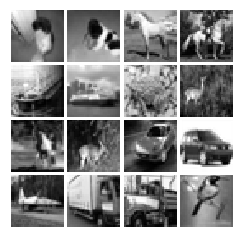

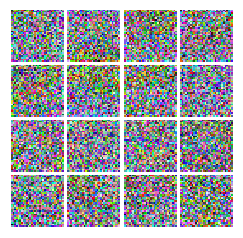

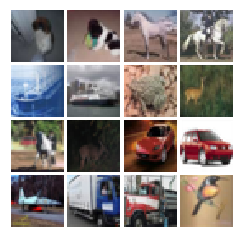

Iter: 0, D: 1.387, G:3.354
Iter: 50, D: 0.0538, G:6.745
Iter: 100, D: 0.01198, G:9.003
Iter: 150, D: 0.003247, G:10.73
Iter: 200, D: 0.001044, G:13.24


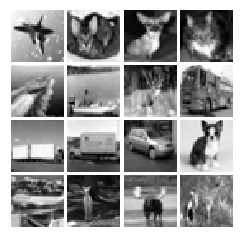

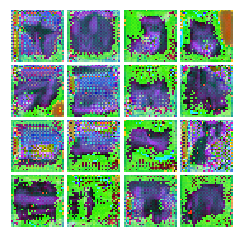

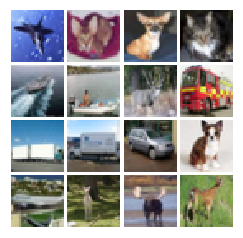

Iter: 250, D: 0.06606, G:7.608
Iter: 300, D: 0.05709, G:4.933
Iter: 350, D: 0.03598, G:6.84
Iter: 400, D: 0.05282, G:5.46
Iter: 450, D: 0.1228, G:4.542


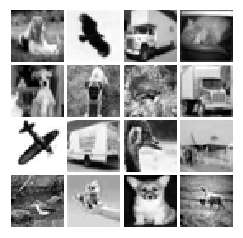

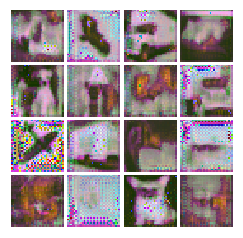

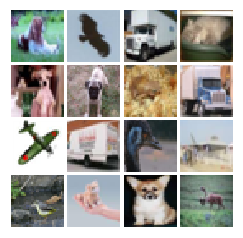

Iter: 500, D: 0.2511, G:2.798
Iter: 550, D: 0.5936, G:3.062
Iter: 600, D: 0.3123, G:2.244
Iter: 650, D: 0.3248, G:3.537
Iter: 700, D: 0.2537, G:3.205


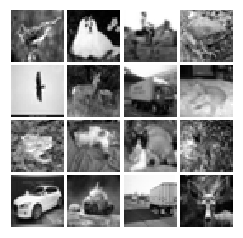

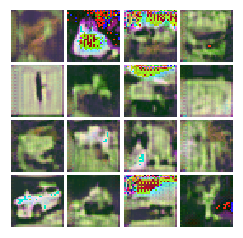

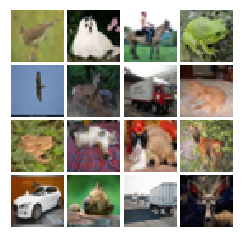

Iter: 750, D: 0.1911, G:4.243
Iter: 800, D: 0.2277, G:3.35
Iter: 850, D: 0.4695, G:2.951
Iter: 900, D: 0.2221, G:4.433
Iter: 950, D: 0.2553, G:3.035


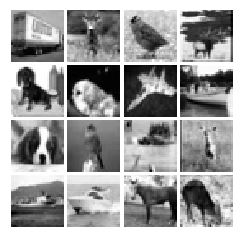

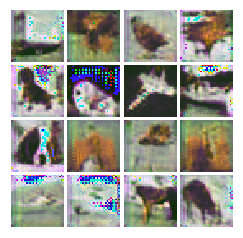

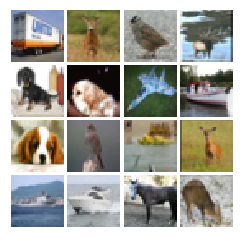

Iter: 1000, D: 0.08508, G:4.836
Iter: 1050, D: 0.3547, G:4.641
Iter: 1100, D: 0.2367, G:3.076
Iter: 1150, D: 0.2207, G:2.74
Iter: 1200, D: 0.1418, G:5.053


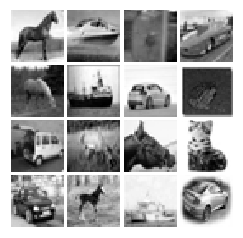

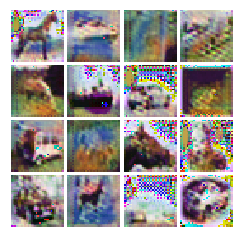

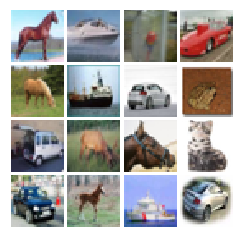

Iter: 1250, D: 0.2111, G:4.501
Iter: 1300, D: 1.176, G:3.757
Iter: 1350, D: 0.3295, G:5.323
Iter: 1400, D: 0.1365, G:4.073
Iter: 1450, D: 0.1733, G:3.262


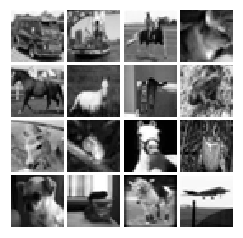

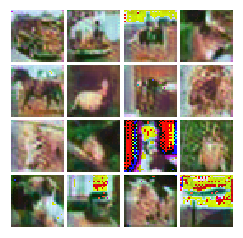

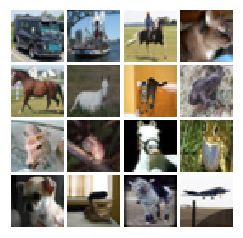

Iter: 1500, D: 0.1438, G:5.104
Iter: 1550, D: 0.2927, G:3.093
Iter: 1600, D: 0.1329, G:4.044
Iter: 1650, D: 0.1544, G:4.877
Iter: 1700, D: 0.7409, G:1.929


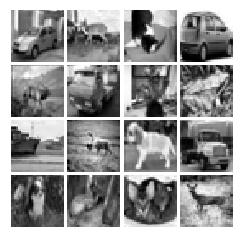

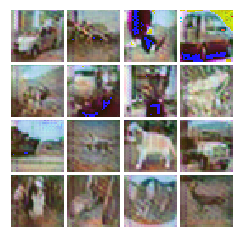

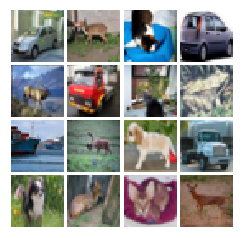

Iter: 1750, D: 0.1145, G:4.676
Iter: 1800, D: 0.1561, G:4.109
Iter: 1850, D: 0.1343, G:5.074
Iter: 1900, D: 0.7082, G:3.308
Iter: 1950, D: 0.06549, G:4.704


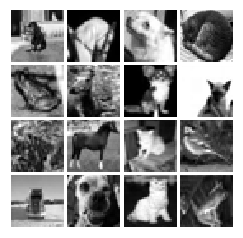

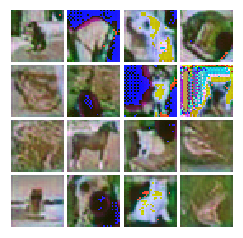

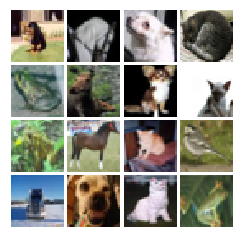

Iter: 2000, D: 0.3482, G:4.644
Iter: 2050, D: 0.1355, G:4.16
Iter: 2100, D: 0.1392, G:3.495
Iter: 2150, D: 0.288, G:4.867
Iter: 2200, D: 0.2465, G:3.871


KeyboardInterrupt: 

In [40]:
sess = tf.Session()
#saver = tf.train.Saver()
#saver.restore(sess,'../models/gan_model_cifar_point6')
sess.run(tf.global_variables_initializer())
run_a_gan(sess, G_train_step, G_loss, D_train_step, D_loss, G_extra_step, D_extra_step,num_epoch = 30)

In [23]:
saver = tf.train.Saver()
saver.save(sess,'../models/gan_model_cifar_point6_l2_full')

'../models/gan_model_cifar_point6_l2_full'

In [13]:
def generator(X):
    
    with tf.variable_scope("generator"):
        Float_image = X
        conv_mat = tf.constant(np.array([[0.299,0.587,0.114],[-0.14713,-0.2888,0.436],[0.615,-0.514999,-0.10001]]),dtype = tf.float32)
        inv_conv_mat = tf.constant(np.array([[1,0,1.13983],[1,-0.39465,-0.58060],[1,2.03211,0]]),dtype = tf.float32)

        Float_image = tf.reshape(Float_image,[-1,3])

        YUV_image = tf.matmul(Float_image,conv_mat)
        YUV_image = tf.reshape(YUV_image,[-1,32,32,3])
        Float_image = tf.reshape(Float_image,[-1,32,32,3])
        UV_p = YUV_image[:,:,:,1:3]
        Y_p = YUV_image[:,:,:,0:1]
        noise = tf.random_normal(shape = tf.shape(Y_p),mean = 0.0,stddev = 0.001)
        Y_pn = Y_p + noise

        a1 = tf.layers.conv2d(Y_pn,filters = 8,kernel_size = [3,3],activation = leaky_relu,padding = 'same')
        a1 = tf.layers.batch_normalization(a1,training = True)
        a1 = tf.layers.conv2d(a1,filters = 16,kernel_size = [3,3],activation = leaky_relu,padding = 'same')
        a1 = tf.layers.conv2d(a1,filters = 16,kernel_size = [3,3],activation = leaky_relu,padding = 'same')
        a1 = tf.layers.conv2d(a1,filters = 16,kernel_size = [3,3],activation = leaky_relu,padding = 'same')
        a1 = tf.layers.batch_normalization(a1,training = True)
        a1 = tf.layers.conv2d(a1,filters = 32,kernel_size = [3,3],activation = leaky_relu,padding = 'same')
        a1 = tf.layers.batch_normalization(a1,training = True)
        
        #a1 = tf.layers.max_pooling2d(a1,pool_size = [2,2],strides = [2,2])
        
        a1 = tf.layers.conv2d(a1,filters = 32,kernel_size = [3,3],activation = leaky_relu,padding = 'same')
        a1 = tf.layers.batch_normalization(a1,training = True)
        #a1 = tf.layers.conv2d(a1,filters = 64,kernel_size = [3,3],activation = leaky_relu,padding = 'same')
        #a1 = tf.layers.batch_normalization(a1,training = True)
        a1 = tf.layers.conv2d(a1,filters = 64,kernel_size = [3,3],activation = leaky_relu,padding = 'same')
        a1 = tf.layers.batch_normalization(a1,training = True)
        
        #a1 = tf.layers.conv2d_transpose(a1,filters = 64, kernel_size = [4,4],strides = [2,2],activation = leaky_relu,padding = 'same')
        #a1 = tf.layers.batch_normalization(a1,training = True)
        
        #a1 = tf.layers.dropout(a1,training=True,rate = 0.5)
        
        a1 = tf.layers.conv2d(a1,filters = 32,kernel_size = [3,3],activation = leaky_relu,padding = 'same')
        a1 = tf.layers.batch_normalization(a1,training = True)
        
        
        #a1  = tf.layers.dropout(a1,training=True,rate = 0.5)
        
        a1 = tf.layers.conv2d(a1,filters = 16,kernel_size = [1,1],activation = leaky_relu,padding = 'same')
        a1 = tf.layers.batch_normalization(a1,training = True)
        a1 = tf.layers.conv2d(a1,filters = 16,kernel_size = [1,1],activation = leaky_relu,padding = 'same')
        a1 = tf.layers.batch_normalization(a1,training = True)
        
        #tf.layers.dropout(a1,training=True,rate = 0.5)
        
        a1 = tf.layers.conv2d(a1,filters = 8,kernel_size = [1,1],activation = leaky_relu,padding = 'same')
        a1 = tf.layers.batch_normalization(a1,training = True)
        a1 = tf.layers.conv2d(a1,filters = 4,kernel_size = [1,1],activation = leaky_relu,padding = 'same')
        a1 = tf.layers.batch_normalization(a1,training = True)
        a1 = tf.layers.conv2d(a1,filters = 2,kernel_size = [1,1],activation = tf.tanh,padding = 'same')
        #a1 = 0.6*a1



        a3 = tf.concat((Y_p,a1),axis = 3)
        a2 = tf.image.hsv_to_rgb(a3)
        a3 = tf.reshape(a3,[-1,3])
        a2 = tf.matmul(a3,inv_conv_mat)
        RGB_out = tf.reshape(a2,[-1,32,32,3])
        #RGB_out = a1
    
    return RGB_out,Y_p

In [28]:
def skip_generator(X):
    
    with tf.variable_scope("generator"):
        Float_image = X
        conv_mat = tf.constant(np.array([[0.299,0.587,0.114],[-0.14713,-0.2888,0.436],[0.615,-0.514999,-0.10001]]),dtype = tf.float32)
        inv_conv_mat = tf.constant(np.array([[1,0,1.13983],[1,-0.39465,-0.58060],[1,2.03211,0]]),dtype = tf.float32)

        Float_image = tf.reshape(Float_image,[-1,3])

        YUV_image = tf.matmul(Float_image,conv_mat)
        YUV_image = tf.reshape(YUV_image,[-1,32,32,3])
        Float_image = tf.reshape(Float_image,[-1,32,32,3])
        UV_p = YUV_image[:,:,:,1:3]
        Y_p = YUV_image[:,:,:,0:1]
        noise = tf.random_normal(shape = tf.shape(Y_p),mean = 0.0,stddev = 0.001)
        Y_pn = Y_p + noise

        a1 = tf.layers.conv2d(Y_pn,filters = 8,kernel_size = [3,3],activation = leaky_relu,padding = 'same')
        a1 = tf.layers.batch_normalization(a1,training = True)
        a1 = tf.layers.conv2d(a1,filters = 16,kernel_size = [3,3],activation = leaky_relu,padding = 'same')
        a1 = tf.concat((Y_pn,a1),axis = 3)
        a1 = tf.layers.batch_normalization(a1,training = True)
        a1 = tf.layers.conv2d(a1,filters = 32,kernel_size = [3,3],activation = leaky_relu,padding = 'same')
        a1 = tf.layers.batch_normalization(a1,training = True)
        
        #a1 = tf.layers.max_pooling2d(a1,pool_size = [2,2],strides = [2,2])
        
        a1 = tf.layers.conv2d(a1,filters = 32,kernel_size = [3,3],activation = leaky_relu,padding = 'same')
        a1 = tf.concat((Y_pn,a1),axis = 3)
        a1 = tf.layers.batch_normalization(a1,training = True)
        #a1 = tf.layers.conv2d(a1,filters = 64,kernel_size = [3,3],activation = leaky_relu,padding = 'same')
        #a1 = tf.layers.batch_normalization(a1,training = True)
        a1 = tf.layers.conv2d(a1,filters = 64,kernel_size = [3,3],activation = leaky_relu,padding = 'same')
        a1 = tf.layers.batch_normalization(a1,training = True)
        
        #a1 = tf.layers.conv2d_transpose(a1,filters = 64, kernel_size = [4,4],strides = [2,2],activation = leaky_relu,padding = 'same')
        #a1 = tf.layers.batch_normalization(a1,training = True)
        
        #a1 = tf.layers.dropout(a1,training=True,rate = 0.5)
        
        a1 = tf.layers.conv2d(a1,filters = 32,kernel_size = [3,3],activation = leaky_relu,padding = 'same')
        a1 = tf.concat((Y_pn,a1),axis = 3)
        a1 = tf.layers.batch_normalization(a1,training = True)
        
        
        #a1  = tf.layers.dropout(a1,training=True,rate = 0.5)
        
        a1 = tf.layers.conv2d(a1,filters = 16,kernel_size = [1,1],activation = leaky_relu,padding = 'same')
        a1 = tf.layers.batch_normalization(a1,training = True)
        a1 = tf.layers.conv2d(a1,filters = 16,kernel_size = [1,1],activation = leaky_relu,padding = 'same')
        a1 = tf.concat((Y_pn,a1),axis = 3)
        a1 = tf.layers.batch_normalization(a1,training = True)
        
        #tf.layers.dropout(a1,training=True,rate = 0.5)
        
        a1 = tf.layers.conv2d(a1,filters = 8,kernel_size = [1,1],activation = leaky_relu,padding = 'same')
        a1 = tf.layers.batch_normalization(a1,training = True)
        a1 = tf.layers.conv2d(a1,filters = 4,kernel_size = [1,1],activation = leaky_relu,padding = 'same')
        a1 = tf.layers.batch_normalization(a1,training = True)
        a1 = tf.layers.conv2d(a1,filters = 2,kernel_size = [1,1],activation = tf.tanh,padding = 'same')
        #a1 = 0.6*a1



        a3 = tf.concat((Y_p,a1),axis = 3)
        a2 = tf.image.hsv_to_rgb(a3)
        a3 = tf.reshape(a3,[-1,3])
        a2 = tf.matmul(a3,inv_conv_mat)
        RGB_out = tf.reshape(a2,[-1,32,32,3])
        #RGB_out = a1
    
    return RGB_out,Y_p

In [13]:
def discriminator(x):
    """Compute discriminator score for a batch of input images.
    
    Inputs:
    - x: TensorFlow Tensor of flattened input images, shape [batch_size, 784]
    
    Returns:
    TensorFlow Tensor with shape [batch_size, 1], containing the score 
    for an image being real for each input image.
    """
    with tf.variable_scope("discriminator"):
        # TODO: implement architecture
        #reshaped_x = tf.transpose(x,perm = [0,2,3,1])
        reshaped_x = x
        a1 = tf.layers.conv2d(reshaped_x,filters = 32,kernel_size = [5,5],activation = leaky_relu,padding = 'same')
        #a1 = tf.layers.batch_normalization(a1,training = True)
        #a1 = tf.layers.max_pooling2d(a1,pool_size = [2,2],strides = [2,2])
        a1 = tf.layers.conv2d(a1,filters = 64,kernel_size = [5,5],strides = [2,2], activation = leaky_relu,padding = 'same')
        #new conv layer ## differnece of cifar 10_l2_drop model
        a1 = tf.layers.conv2d(a1,filters = 64,kernel_size = [5,5],activation = leaky_relu,padding = 'same')
        #a1 = tf.layers.max_pooling2d(a1,pool_size = [2,2],strides = [2,2])
        a1 = tf.layers.conv2d(a1,filters = 128,kernel_size = [3,3],strides = [2,2],activation = leaky_relu,padding = 'same')
        #new conv layer
        a1 = tf.layers.conv2d(a1,filters = 128,kernel_size = [3,3],activation = leaky_relu,padding = 'same')
        
        #a1 = tf.layers.max_pooling2d(a1,pool_size = [2,2],strides = [2,2])
        a1 = tf.layers.conv2d(a1,filters = 256,kernel_size = [3,3],strides = [2,2],activation = leaky_relu,padding = 'same')
        #new dropout layer
        a1 = tf.layers.dropout(a1,training=True,rate = 0.5)
        #a1 = tf.layers.max_pooling2d(a1,pool_size = [2,2],strides = [2,2])
        a1 = tf.layers.conv2d(a1,filters = 512,kernel_size = [3,3],strides = [2,2],activation = leaky_relu,padding = 'same')
        a1 = tf.layers.conv2d(a1,filters = 512,kernel_size = [3,3],strides = [2,2],activation = leaky_relu,padding = 'same')
        #a1 = tf.layers.max_pooling2d(a1,pool_size = [2,2],strides = [2,2])
        #new dropout layer
        a1 = tf.layers.dropout(a1,training=True,rate = 0.5)
        a1 = tf.reshape(a1,shape=[-1,512])
        a1 = tf.layers.dense(a1,512,activation = leaky_relu)
        logits = tf.layers.dense(a1,1)
        #logits2 = tf.layers.dense(a1,10)
        
        
        return logits

In [14]:
BATCH_SIZE = 128
LAMBDA = 10
def wcgan_loss(disc_real,disc_fake,real_data,fake_data):
    gen_cost = -tf.reduce_mean(disc_fake)
    disc_cost = tf.reduce_mean(disc_fake) - tf.reduce_mean(disc_real)
    #alpha = tf.random_uniform(shape=[BATCH_SIZE,1], minval=0., maxval=1.)
    #differences = fake_data - real_data
    #interpolates = real_data + (alpha*differences)
    #reshaped_interpolate = tf.reshape(interpolates,shape = [-1,32,32,3])
    
    #gradients = tf.gradients(discriminator(reshaped_interpolate), [interpolates])[0]
    #slopes = tf.sqrt(tf.reduce_sum(tf.square(gradients), reduction_indices=[1]))
    #gradient_penalty = tf.reduce_mean((slopes-1.)**2)
    #disc_cost += LAMBDA*gradient_penalty
    return disc_cost,gen_cost

In [15]:
BATCH_SIZE = 128
LAMBDA = 10
def wcgan_loss_grad(disc_real,disc_fake,real_data,fake_data):
    gen_cost = -tf.reduce_mean(disc_fake)
    disc_cost = tf.reduce_mean(disc_fake) - tf.reduce_mean(disc_real)
    alpha = tf.random_uniform(shape=[BATCH_SIZE,1], minval=0., maxval=1.)
    differences = fake_data - real_data
    interpolates = real_data + (alpha*differences)
    reshaped_interpolate = tf.reshape(interpolates,shape = [-1,32,32,3])
    
    gradients = tf.gradients(discriminator(reshaped_interpolate), [reshaped_interpolate])[0]
    slopes = tf.sqrt(tf.reduce_sum(tf.square(gradients), reduction_indices=[1,2,3]))
    gradient_penalty = tf.reduce_mean((slopes-1.)**2)
    disc_cost += LAMBDA*gradient_penalty
    return disc_cost,gen_cost

In [16]:
def get_solvers(learning_rate=1e-4, beta1=0.):
    """Create solvers for GAN training.
    
    Inputs:
    - learning_rate: learning rate to use for both solvers
    - beta1: beta1 parameter for both solvers (first moment decay)
    
    Returns:
    - D_solver: instance of tf.train.AdamOptimizer with correct learning_rate and beta1
    - G_solver: instance of tf.train.AdamOptimizer with correct learning_rate and beta1
    """
    D_solver = None
    G_solver = None
    D_solver = tf.train.AdamOptimizer(learning_rate = learning_rate,beta1 = beta1,beta2=0.9)
    G_solver = tf.train.AdamOptimizer(learning_rate = learning_rate,beta1 = beta1,beta2=0.9)
    #D_solver = tf.train.RMSPropOptimizer(learning_rate = learning_rate)
    #G_solver = tf.train.RMSPropOptimizer(learning_rate = learning_rate)
    return D_solver, G_solver

In [17]:
tf.reset_default_graph()

batch_size = 128
# our noise dimension
noise_dim = 96

# placeholders for images from the training dataset
x = tf.placeholder(tf.float32, [batch_size, 32,32,3])
y = tf.placeholder(tf.float32,[batch_size,10])
#z = sample_noise(batch_size, noise_dim)
# generated images
G_sample,G_in = generator(x)

with tf.variable_scope("") as scope:
    #scale images to be -1 to 1
    logits_real = discriminator(x)
    # Re-use discriminator weights on new inputs
    scope.reuse_variables()
    logits_fake = discriminator(G_sample)
    x_reshaped = tf.reshape(x,shape = [-1,32*32*3])
    G_sample_reshaped = tf.reshape(G_sample,shape = [-1,32*32*3])
    scope.reuse_variables()
    D_loss, G_loss = wcgan_loss_grad(logits_real, logits_fake,x_reshaped,G_sample_reshaped)

# Get the list of variables for the discriminator and generator
D_vars = tf.get_collection(tf.GraphKeys.TRAINABLE_VARIABLES,'discriminator')
G_vars = tf.get_collection(tf.GraphKeys.TRAINABLE_VARIABLES,'generator') 




D_solver,G_solver = get_solvers(learning_rate = 1e-4)

#G_loss += 4e-5*tf.reduce_mean(tf.nn.l2_loss(x-G_sample))
#G_loss += tf.reduce_mean(tf.square(x-G_sample))
D_train_step = D_solver.minimize(D_loss, var_list=D_vars, colocate_gradients_with_ops=True)
G_train_step = G_solver.minimize(G_loss, var_list=G_vars, colocate_gradients_with_ops=True)
D_extra_step = tf.get_collection(tf.GraphKeys.UPDATE_OPS,'discriminator')
G_extra_step = tf.get_collection(tf.GraphKeys.UPDATE_OPS,'generator')

In [18]:
def run_a_gan(sess, G_train_step, G_loss, D_train_step, D_loss, G_extra_step, D_extra_step,\
              show_every=250, print_every=50, batch_size=128, num_epoch=10):
    """Train a GAN for a certain number of epochs.
    
    Inputs:
    - sess: A tf.Session that we want to use to run our data
    - G_train_step: A training step for the Generator
    - G_loss: Generator loss
    - D_train_step: A training step for the Generator
    - D_loss: Discriminator loss
    - G_extra_step: A collection of tf.GraphKeys.UPDATE_OPS for generator
    - D_extra_step: A collection of tf.GraphKeys.UPDATE_OPS for discriminator
    Returns:
        Nothing
    """
    # compute the number of iterations we need
    max_iter = int(50000*num_epoch/batch_size)
    for it in range(max_iter):
        # every show often, show a sample result
        if it % show_every == 0:
            rand_indices = np.random.choice(np.arange(10000),batch_size)
            minibatch = X_test[rand_indices]
            samples_gray = sess.run(G_in,feed_dict = {x:minibatch})
            fig = show_images2(samples_gray[:16])
            plt.show()
            samples = sess.run(G_sample,feed_dict = {x:minibatch})
            #samples[samples>1] = 1
            #samples[samples <0] = 0
            fig = show_images(samples[:16])
            plt.show()
            fig = show_images(minibatch[:16])
            plt.show()
            #print ("saving current model")
            #saver.save(sess,'../models/gan_model_cifar_point6')
            
            #print()
        # run a batch of data through the network
        #minibatch,minbatch_y = mnist.train.next_batch(batch_size)
        #for i in range(5):
        rand_indices = np.random.choice(np.arange(50000),batch_size)
        minibatch = X_train[rand_indices]
        #print(minibatch.dtype)
        #print (minibatch.shape)
        _, D_loss_curr = sess.run([D_train_step, D_loss], feed_dict={x: minibatch})
            #while(D_loss_curr > 0.2):
         #   rand_indices = np.random.choice(np.arange(50000),batch_size)
          #  minibatch = X_train[rand_indices]
           # _, D_loss_curr = sess.run([D_train_step, D_loss], feed_dict={x: minibatch})
        rand_indices = np.random.choice(np.arange(50000),batch_size)
        minibatch = X_train[rand_indices]  
        _, G_loss_curr = sess.run([G_train_step, G_loss], feed_dict = {x:minibatch})
        
       # while(G_loss_curr > 0.2):
        #    rand_indices = np.random.choice(np.arange(50000),batch_size)
         #   minibatch = X_train[rand_indices]
          #  _, G_loss_curr = sess.run([G_train_step, G_loss], feed_dict = {x:minibatch})

        # print loss every so often.
        # We want to make sure D_loss doesn't go to 0
        if it % print_every == 0:
            print('Iter: {}, D: {:.4}, G:{:.4}'.format(it,D_loss_curr,G_loss_curr))
    #print('Final images')
    #samples = sess.run(G_sample)

    #fig = show_images(samples[:16])
    #plt.show()

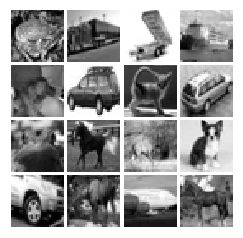

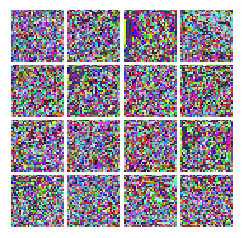

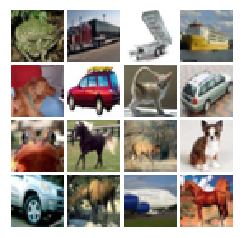

Iter: 0, D: 9.789, G:0.01069
Iter: 50, D: -22.26, G:45.18
Iter: 100, D: -14.93, G:32.63
Iter: 150, D: -13.55, G:11.09
Iter: 200, D: -14.11, G:4.859


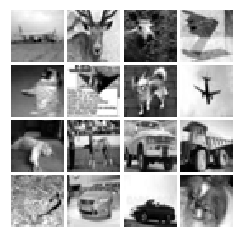

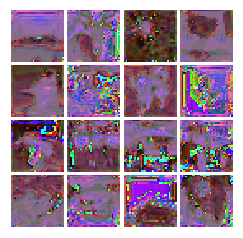

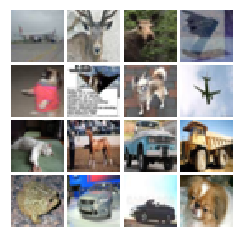

Iter: 250, D: -10.45, G:3.404
Iter: 300, D: -9.593, G:2.046
Iter: 350, D: -6.914, G:-4.452
Iter: 400, D: -7.706, G:5.046
Iter: 450, D: -6.648, G:2.334


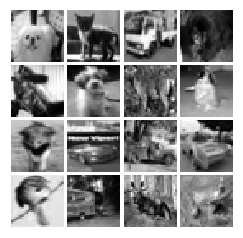

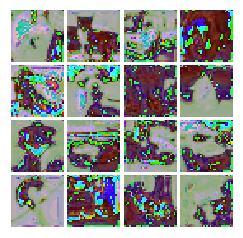

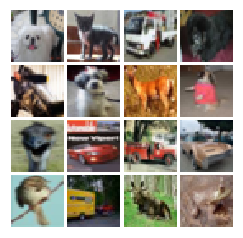

Iter: 500, D: -5.356, G:2.158
Iter: 550, D: -5.417, G:7.419
Iter: 600, D: -3.085, G:-11.8
Iter: 650, D: -3.902, G:7.055
Iter: 700, D: -4.799, G:2.494


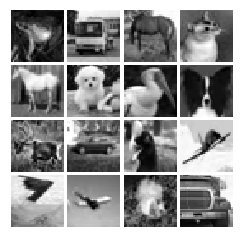

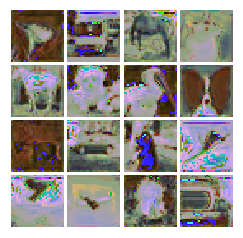

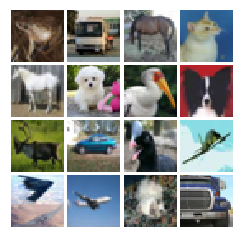

Iter: 750, D: -4.011, G:8.116
Iter: 800, D: -3.634, G:8.945
Iter: 850, D: -3.737, G:7.286
Iter: 900, D: -2.311, G:3.754
Iter: 950, D: -2.855, G:9.723


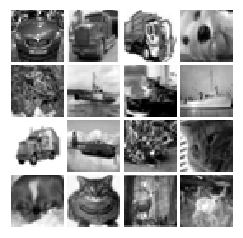

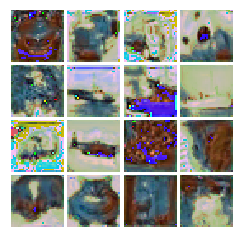

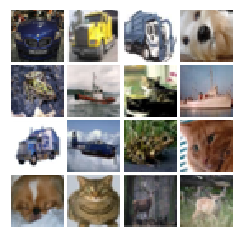

Iter: 1000, D: -1.847, G:8.869
Iter: 1050, D: -3.019, G:8.387
Iter: 1100, D: -2.45, G:7.032
Iter: 1150, D: -2.101, G:10.56
Iter: 1200, D: -2.522, G:5.556


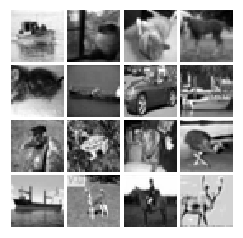

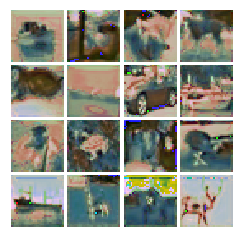

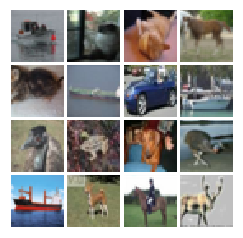

Iter: 1250, D: -1.957, G:5.186
Iter: 1300, D: -1.242, G:5.49
Iter: 1350, D: -1.441, G:8.983
Iter: 1400, D: -0.7249, G:3.03
Iter: 1450, D: -1.378, G:1.574


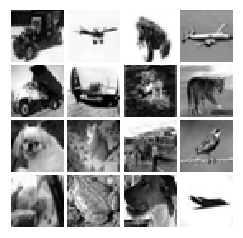

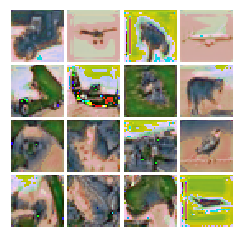

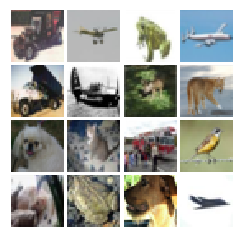

Iter: 1500, D: -0.9538, G:-0.1614
Iter: 1550, D: -0.6412, G:3.201
Iter: 1600, D: -0.9557, G:6.978
Iter: 1650, D: -1.088, G:4.474
Iter: 1700, D: -1.315, G:7.577


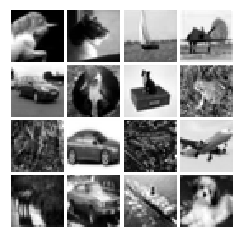

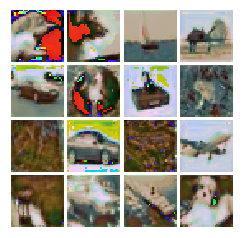

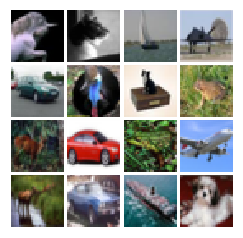

Iter: 1750, D: -1.885, G:4.875
Iter: 1800, D: -2.424, G:5.771
Iter: 1850, D: -2.026, G:2.211
Iter: 1900, D: -2.355, G:6.786
Iter: 1950, D: -0.1497, G:1.736


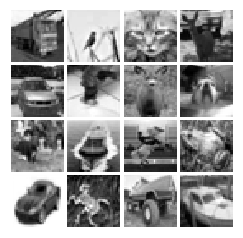

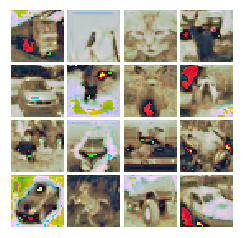

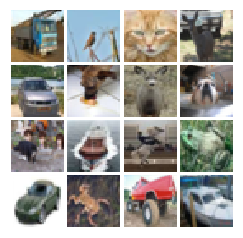

Iter: 2000, D: -1.471, G:5.211
Iter: 2050, D: -1.245, G:3.144
Iter: 2100, D: -2.334, G:2.247
Iter: 2150, D: -0.956, G:0.7297
Iter: 2200, D: -0.184, G:2.919


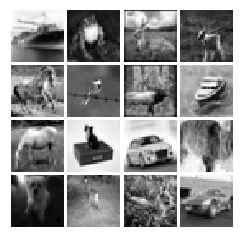

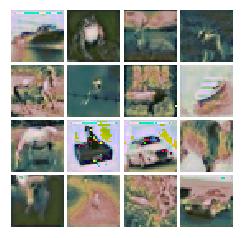

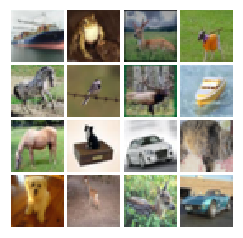

Iter: 2250, D: -0.4722, G:3.755
Iter: 2300, D: -3.677, G:4.067
Iter: 2350, D: -2.519, G:5.704
Iter: 2400, D: 0.7518, G:7.786
Iter: 2450, D: -1.391, G:4.132


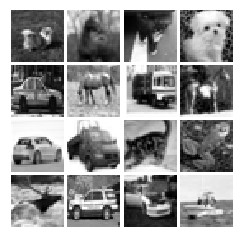

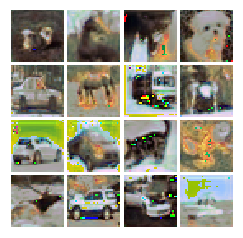

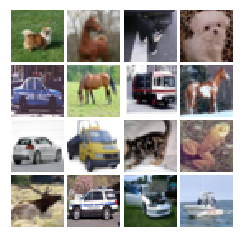

Iter: 2500, D: -2.004, G:3.493
Iter: 2550, D: -0.09925, G:6.971
Iter: 2600, D: -4.876, G:7.715
Iter: 2650, D: -1.01, G:5.179
Iter: 2700, D: -1.231, G:6.244


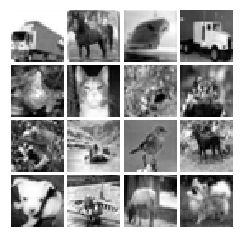

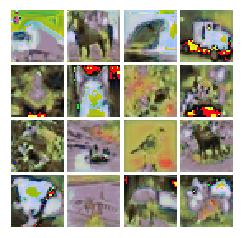

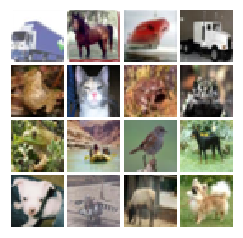

Iter: 2750, D: -0.8378, G:1.026
Iter: 2800, D: -1.763, G:3.021
Iter: 2850, D: -2.635, G:-0.6348
Iter: 2900, D: 0.2083, G:6.412
Iter: 2950, D: 0.002396, G:4.991


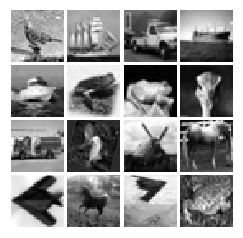

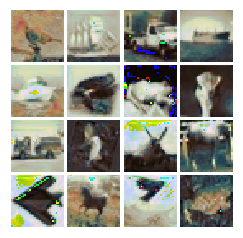

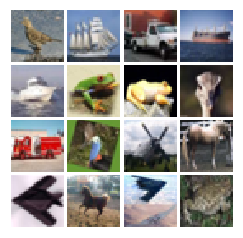

Iter: 3000, D: 1.55, G:1.911
Iter: 3050, D: -8.132, G:10.64
Iter: 3100, D: 2.163, G:1.039
Iter: 3150, D: 0.4852, G:3.921
Iter: 3200, D: 0.5602, G:5.355


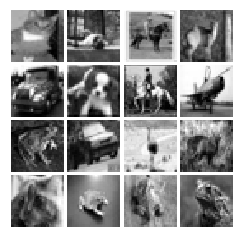

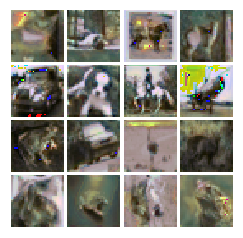

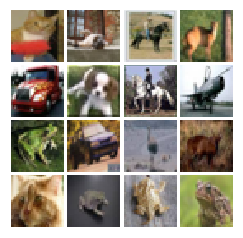

Iter: 3250, D: -0.6146, G:7.056
Iter: 3300, D: -1.601, G:0.8121
Iter: 3350, D: -4.039, G:5.637
Iter: 3400, D: -1.946, G:2.146
Iter: 3450, D: 1.034, G:16.83


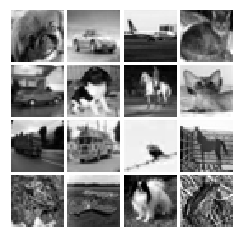

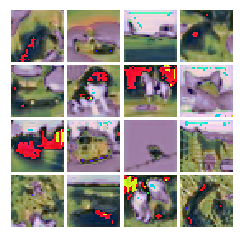

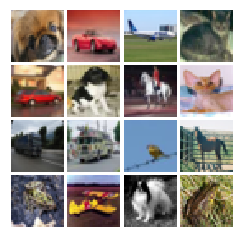

Iter: 3500, D: -1.863, G:8.721
Iter: 3550, D: -1.1, G:2.951
Iter: 3600, D: -2.606, G:8.273
Iter: 3650, D: -0.5164, G:7.414
Iter: 3700, D: -1.183, G:7.675


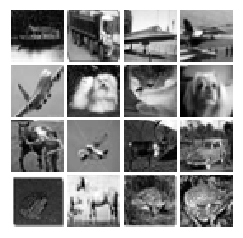

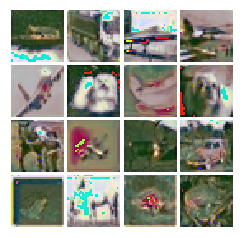

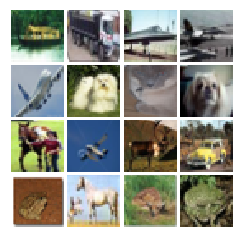

Iter: 3750, D: -1.833, G:5.465
Iter: 3800, D: -1.501, G:5.649
Iter: 3850, D: -1.241, G:9.748
Iter: 3900, D: -2.462, G:3.144
Iter: 3950, D: 2.45, G:13.82


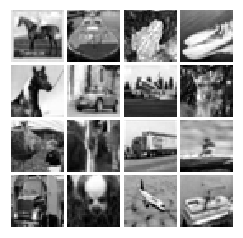

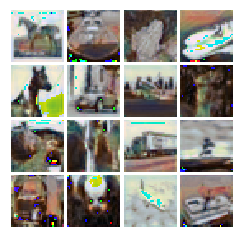

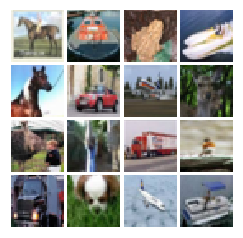

Iter: 4000, D: -2.212, G:3.956
Iter: 4050, D: -2.38, G:13.47
Iter: 4100, D: -2.549, G:10.61
Iter: 4150, D: -0.8568, G:9.952
Iter: 4200, D: -2.231, G:4.913


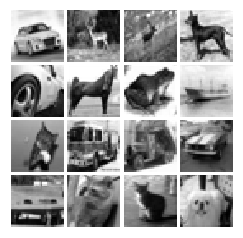

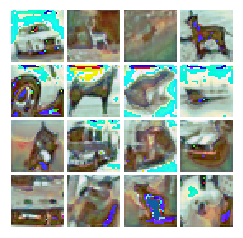

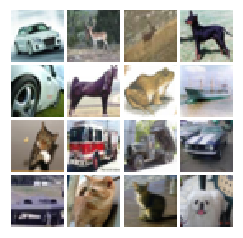

Iter: 4250, D: 1.182, G:11.53
Iter: 4300, D: -1.768, G:5.353
Iter: 4350, D: -0.4526, G:4.858
Iter: 4400, D: -2.035, G:5.743
Iter: 4450, D: -0.9153, G:9.347


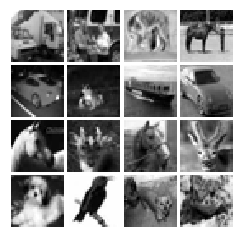

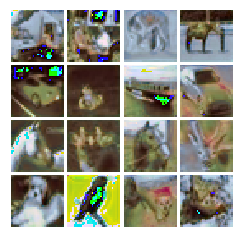

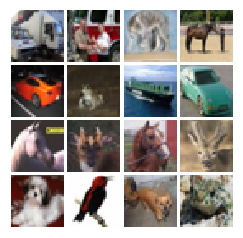

Iter: 4500, D: -0.2193, G:10.52
Iter: 4550, D: -1.083, G:16.35
Iter: 4600, D: -1.798, G:10.55
Iter: 4650, D: -2.114, G:6.339
Iter: 4700, D: -1.936, G:9.399


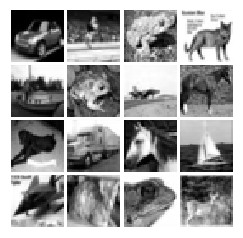

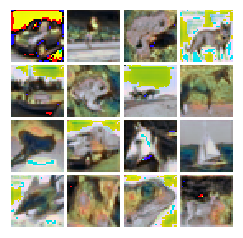

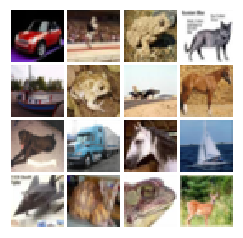

Iter: 4750, D: -1.425, G:6.595
Iter: 4800, D: -1.582, G:5.463
Iter: 4850, D: -5.893, G:6.955
Iter: 4900, D: 0.5271, G:1.204
Iter: 4950, D: 1.52, G:11.29


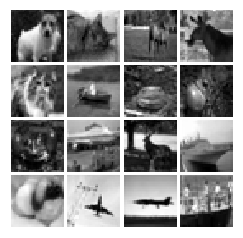

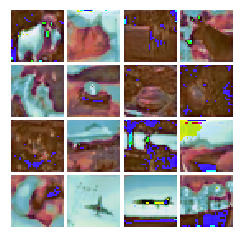

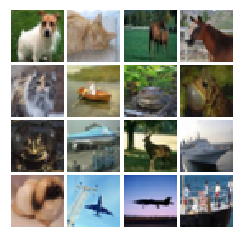

Iter: 5000, D: -1.806, G:11.69
Iter: 5050, D: 0.7038, G:11.02
Iter: 5100, D: -0.582, G:12.06
Iter: 5150, D: -0.8144, G:9.897
Iter: 5200, D: -1.936, G:12.16


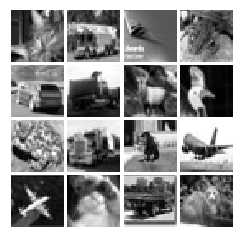

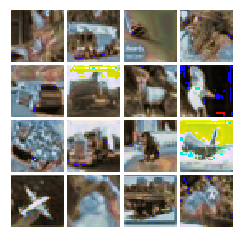

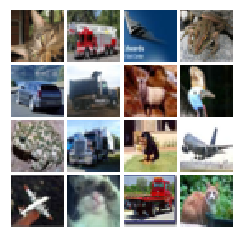

Iter: 5250, D: 0.9007, G:6.56
Iter: 5300, D: -1.674, G:11.75
Iter: 5350, D: 0.0186, G:9.084
Iter: 5400, D: -0.7484, G:7.129
Iter: 5450, D: 0.09341, G:8.471


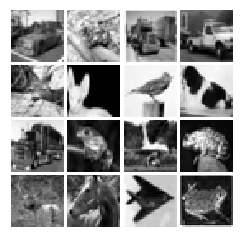

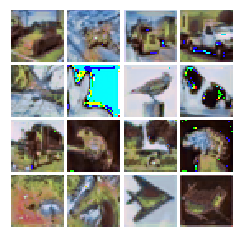

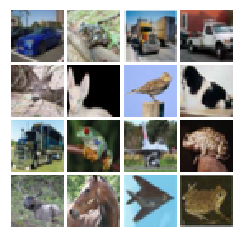

Iter: 5500, D: -0.7551, G:4.465
Iter: 5550, D: -0.8067, G:2.987
Iter: 5600, D: -0.1808, G:13.76
Iter: 5650, D: -1.787, G:10.28
Iter: 5700, D: -2.564, G:5.875


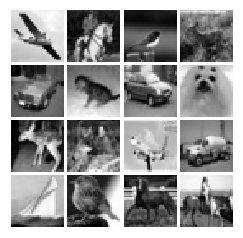

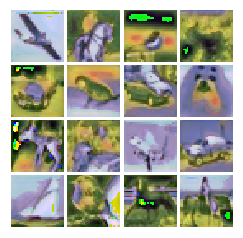

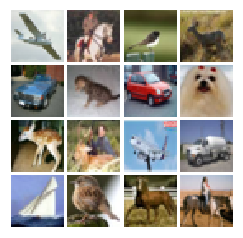

Iter: 5750, D: -2.78, G:13.42
Iter: 5800, D: -1.275, G:8.14
Iter: 5850, D: 0.5324, G:6.356
Iter: 5900, D: -0.8408, G:5.303
Iter: 5950, D: -2.693, G:11.24


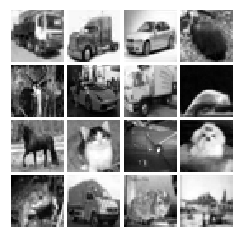

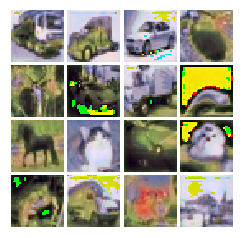

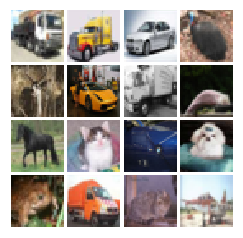

Iter: 6000, D: 0.7218, G:9.274
Iter: 6050, D: -1.112, G:8.142
Iter: 6100, D: -1.006, G:5.789
Iter: 6150, D: -0.8758, G:10.9
Iter: 6200, D: -0.9707, G:4.412


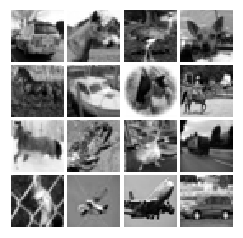

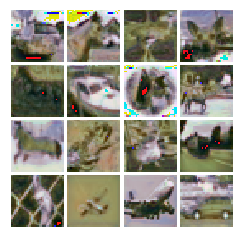

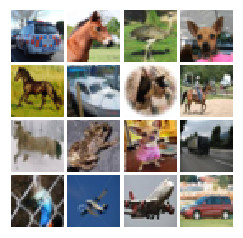

Iter: 6250, D: -0.7211, G:13.02
Iter: 6300, D: -1.222, G:9.328
Iter: 6350, D: -2.723, G:12.05
Iter: 6400, D: -0.4617, G:13.84
Iter: 6450, D: -1.278, G:5.638


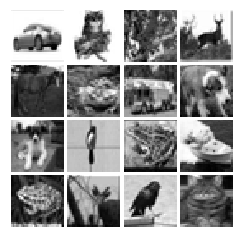

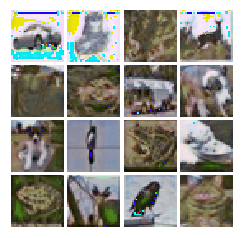

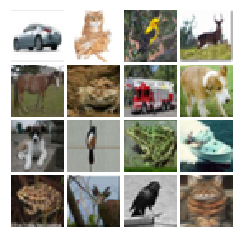

Iter: 6500, D: -0.8147, G:5.775
Iter: 6550, D: -12.7, G:40.13
Iter: 6600, D: -0.05356, G:13.96
Iter: 6650, D: 0.01631, G:7.177
Iter: 6700, D: -2.289, G:5.482


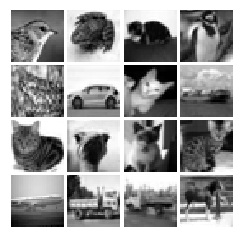

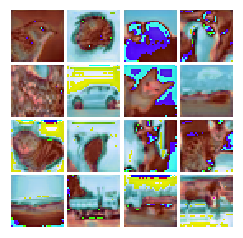

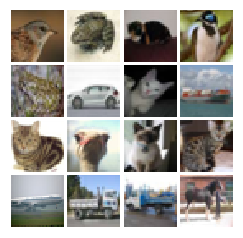

Iter: 6750, D: -1.09, G:5.552
Iter: 6800, D: -0.7947, G:2.325
Iter: 6850, D: -0.3771, G:5.582
Iter: 6900, D: -0.3947, G:4.324
Iter: 6950, D: -2.23, G:3.887


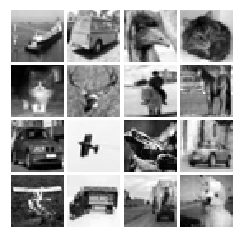

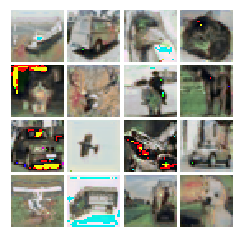

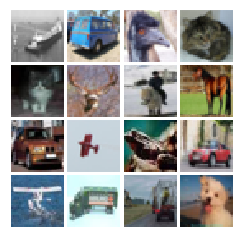

Iter: 7000, D: -0.9432, G:5.459
Iter: 7050, D: 0.02555, G:6.541
Iter: 7100, D: 0.5101, G:4.408
Iter: 7150, D: -1.742, G:10.28
Iter: 7200, D: -2.062, G:5.495


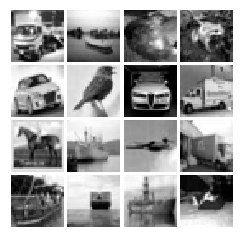

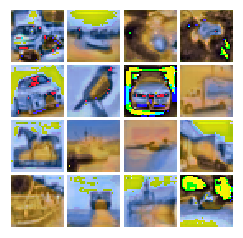

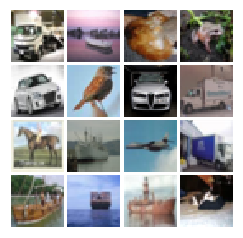

Iter: 7250, D: -0.4623, G:10.48
Iter: 7300, D: -1.028, G:7.62
Iter: 7350, D: -1.678, G:5.432
Iter: 7400, D: -2.731, G:8.181
Iter: 7450, D: -1.248, G:10.4


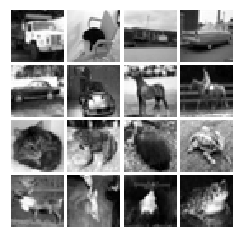

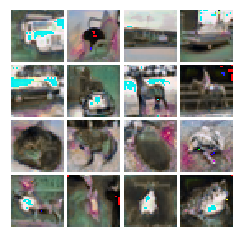

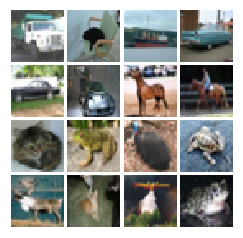

Iter: 7500, D: -1.724, G:2.87
Iter: 7550, D: -1.606, G:8.853
Iter: 7600, D: -1.858, G:5.508
Iter: 7650, D: -0.7526, G:6.444
Iter: 7700, D: -0.1862, G:4.517


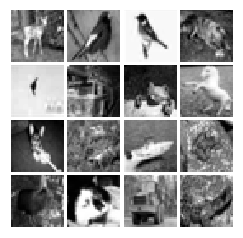

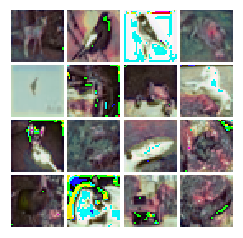

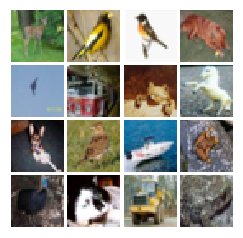

Iter: 7750, D: -1.564, G:4.435
Iter: 7800, D: -0.8141, G:4.659
Iter: 7850, D: -1.031, G:4.027
Iter: 7900, D: -2.933, G:10.19
Iter: 7950, D: 1.478, G:7.313


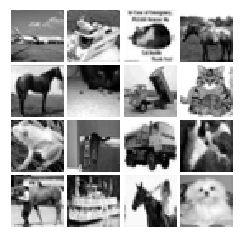

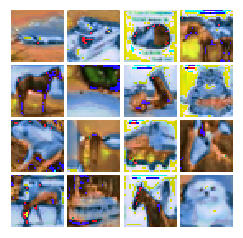

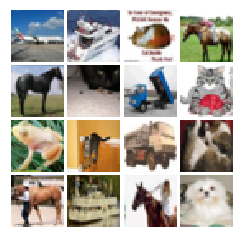

Iter: 8000, D: -2.148, G:9.937
Iter: 8050, D: -1.94, G:10.11
Iter: 8100, D: -0.2073, G:6.938
Iter: 8150, D: -0.8242, G:8.287
Iter: 8200, D: 0.9355, G:12.24


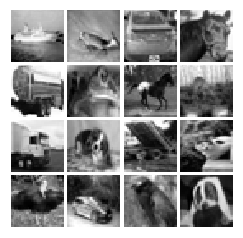

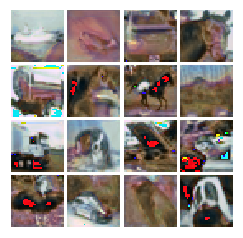

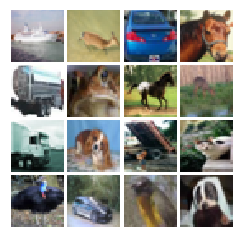

Iter: 8250, D: 2.268, G:10.79
Iter: 8300, D: -0.7634, G:4.874
Iter: 8350, D: -1.997, G:0.8595
Iter: 8400, D: 3.383, G:5.6
Iter: 8450, D: -3.702, G:8.359


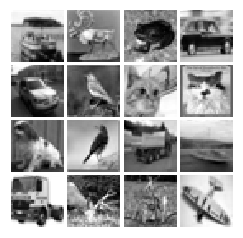

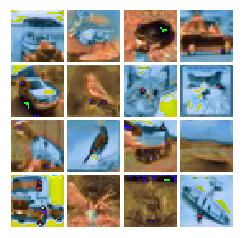

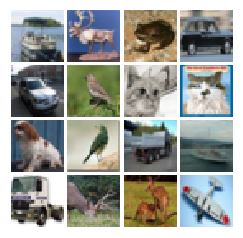

Iter: 8500, D: -2.571, G:13.9
Iter: 8550, D: -0.8072, G:5.576
Iter: 8600, D: -0.6876, G:10.3
Iter: 8650, D: 0.03572, G:0.07143
Iter: 8700, D: -1.297, G:11.19


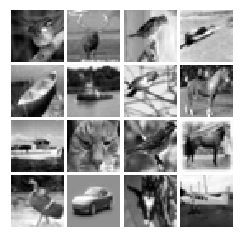

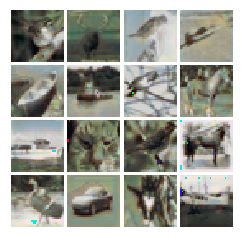

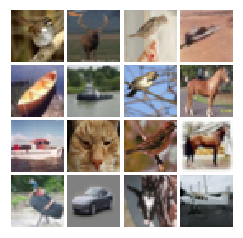

Iter: 8750, D: -9.671, G:12.99
Iter: 8800, D: -1.529, G:11.25
Iter: 8850, D: -6.121, G:12.47
Iter: 8900, D: -2.506, G:14.47
Iter: 8950, D: -19.95, G:17.42


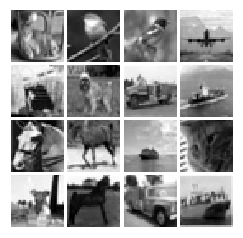

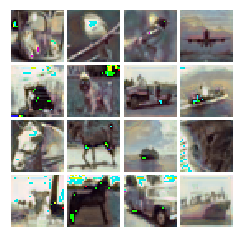

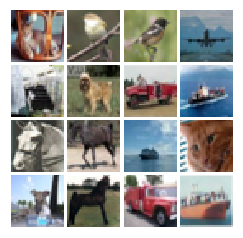

Iter: 9000, D: -2.277, G:7.311
Iter: 9050, D: -1.611, G:7.986
Iter: 9100, D: -0.8255, G:5.119
Iter: 9150, D: -0.6979, G:3.372
Iter: 9200, D: -1.309, G:7.649


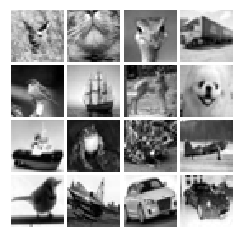

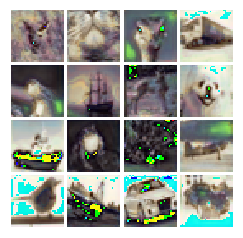

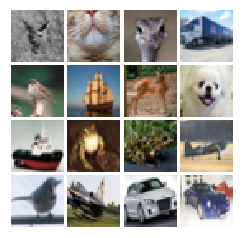

Iter: 9250, D: 0.5468, G:8.756
Iter: 9300, D: -0.02852, G:8.866
Iter: 9350, D: -2.022, G:7.957
Iter: 9400, D: -2.369, G:6.592
Iter: 9450, D: -0.03595, G:6.103


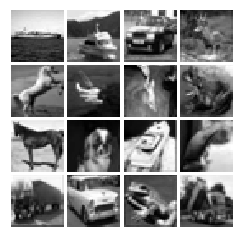

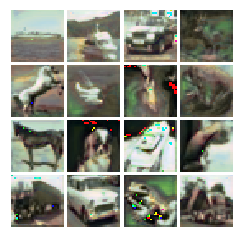

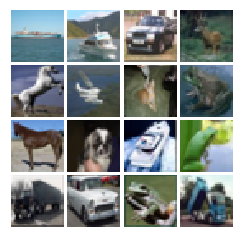

Iter: 9500, D: -0.6136, G:8.935
Iter: 9550, D: -0.1817, G:7.901
Iter: 9600, D: -2.972, G:8.355
Iter: 9650, D: 0.5595, G:9.104
Iter: 9700, D: 0.158, G:5.226


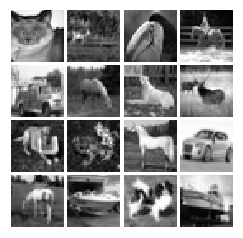

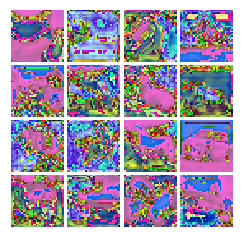

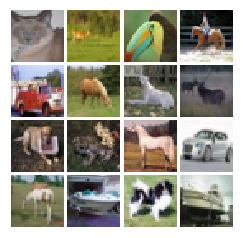

Iter: 9750, D: -3.771, G:15.06
Iter: 9800, D: 0.4934, G:15.04
Iter: 9850, D: 0.9265, G:14.01
Iter: 9900, D: -1.997, G:6.899
Iter: 9950, D: -1.688, G:7.639


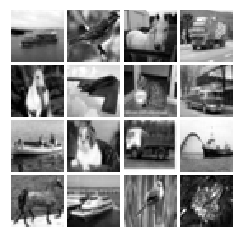

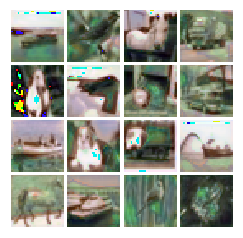

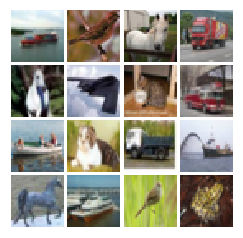

Iter: 10000, D: -0.7822, G:4.481
Iter: 10050, D: -2.339, G:6.647
Iter: 10100, D: 1.077, G:3.641
Iter: 10150, D: -5.239, G:2.895
Iter: 10200, D: 3.145, G:-1.325


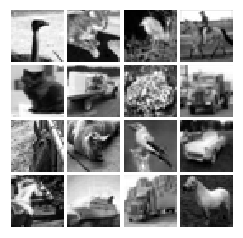

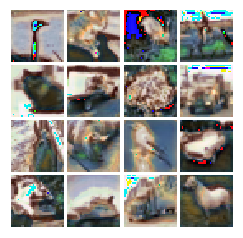

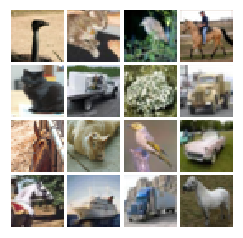

Iter: 10250, D: -2.269, G:7.765
Iter: 10300, D: -1.939, G:13.72
Iter: 10350, D: -0.3663, G:9.742
Iter: 10400, D: -2.162, G:7.692
Iter: 10450, D: -2.391, G:10.95


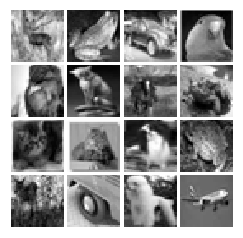

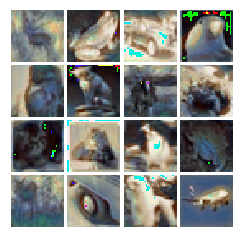

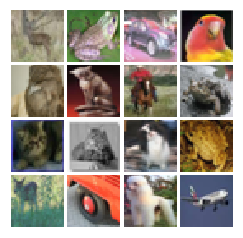

Iter: 10500, D: -2.995, G:8.949
Iter: 10550, D: -1.689, G:10.72
Iter: 10600, D: -0.6696, G:12.08
Iter: 10650, D: -0.01609, G:6.178
Iter: 10700, D: -2.422, G:7.897


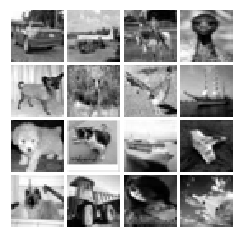

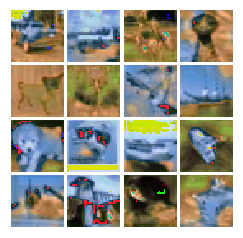

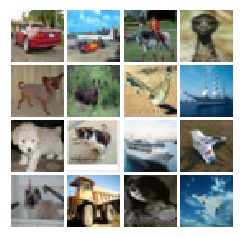

Iter: 10750, D: 2.115, G:16.71


KeyboardInterrupt: 

In [35]:
sess = tf.Session()
saver = tf.train.Saver()
#saver.restore(sess,'../models/gan_model_cifar_point6_ab_out_no_bn')
sess.run(tf.global_variables_initializer())
run_a_gan(sess, G_train_step, G_loss, D_train_step, D_loss, G_extra_step, D_extra_step,num_epoch = 100)

In [36]:
saver = tf.train.Saver()
saver.save(sess,'../models/gan_model_cifar_point6_ab_last_try')

'../models/gan_model_cifar_point6_ab_last_try'

INFO:tensorflow:Restoring parameters from ../models/gan_model_cifar_point6_ab_out


INFO:tensorflow:Restoring parameters from ../models/gan_model_cifar_point6_ab_out


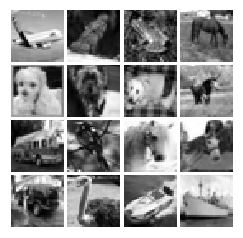

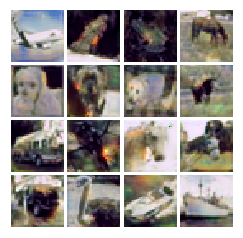

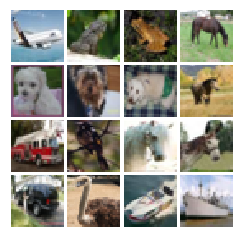

In [23]:
sess = tf.Session()
saver = tf.train.Saver()
saver.restore(sess,'../models/gan_model_cifar_point6_ab_out')
rand_indices = np.random.choice(np.arange(10000),batch_size)
minibatch = X_test[rand_indices]
samples_gray = sess.run(G_in,feed_dict = {x:minibatch})
fig = show_images2(samples_gray[:16])
plt.show()
samples = sess.run(G_sample,feed_dict = {x:minibatch})
samples[samples>1] = 1
samples[samples<0]  = 0
fig = show_images(samples[:16])
plt.show()
fig = show_images(minibatch[:16])
plt.show()

0


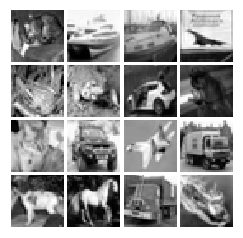

1.0
0.0


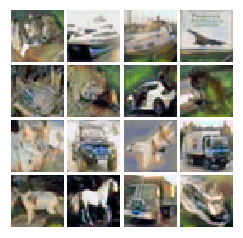

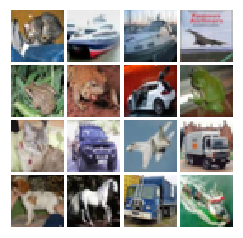

1


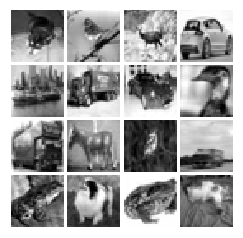

1.0
0.0


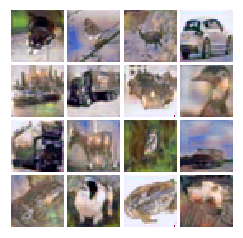

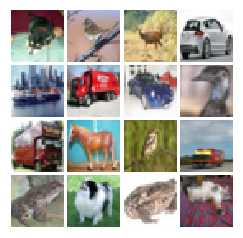

2


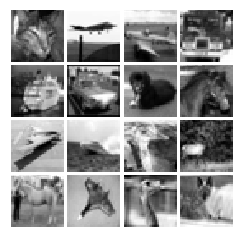

1.0
0.0


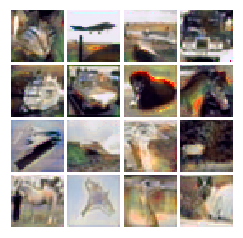

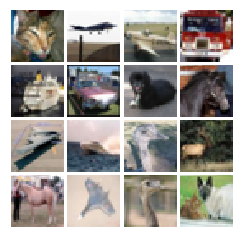

3


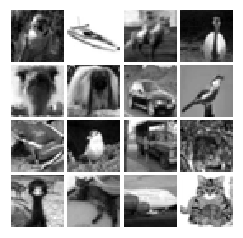

1.0
0.0


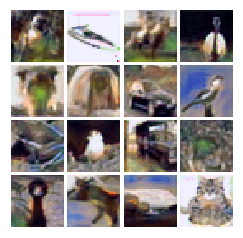

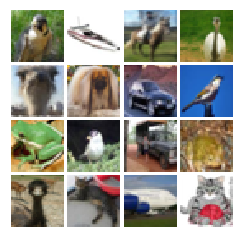

4


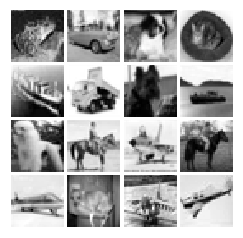

1.0
0.0


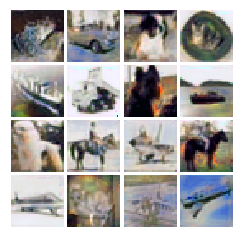

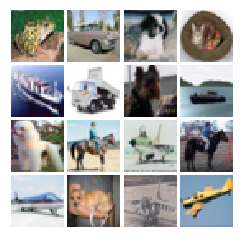

5


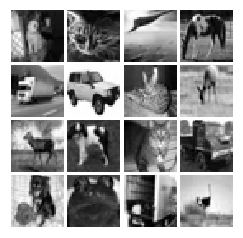

1.0
0.0


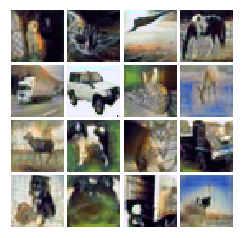

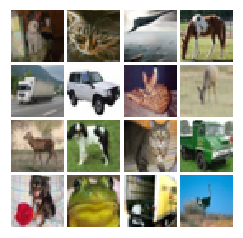

6


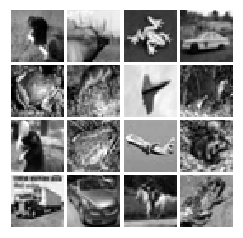

1.0
0.0


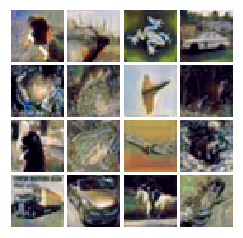

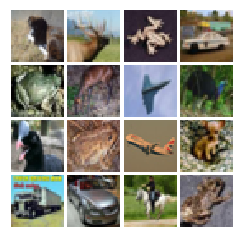

7


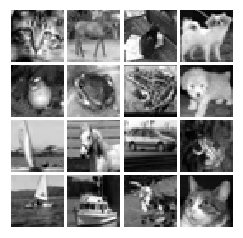

1.0
0.0


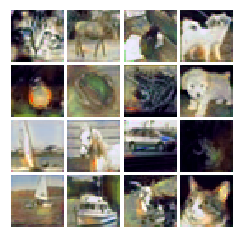

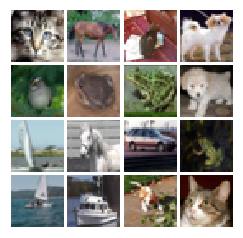

8


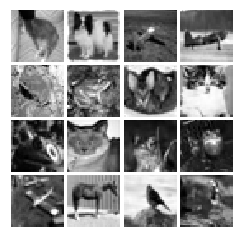

1.0
0.0


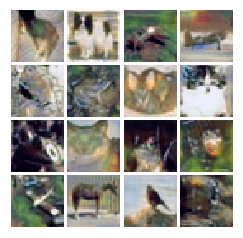

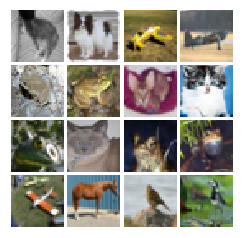

9


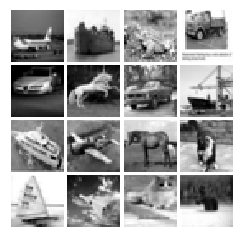

1.0
0.0


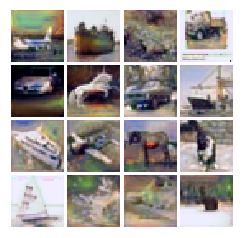

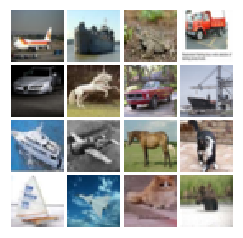

10


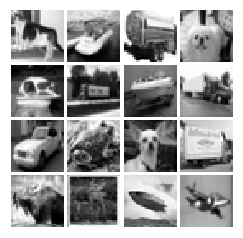

1.0
0.0


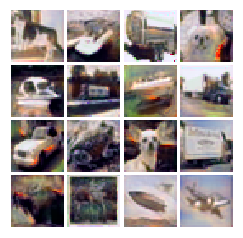

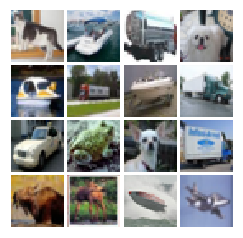

11


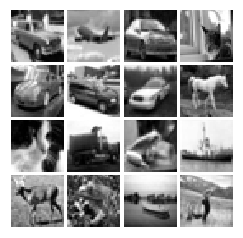

1.0
0.0


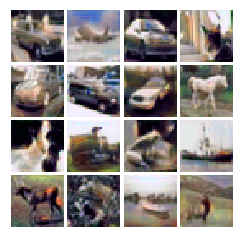

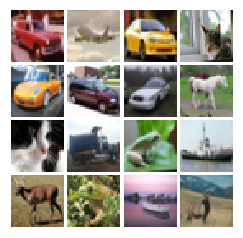

12


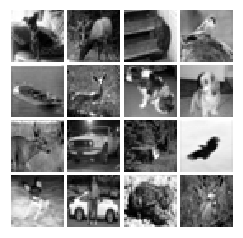

1.0
0.0


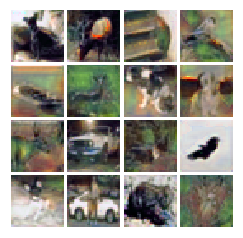

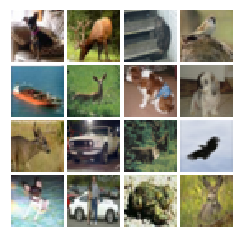

13


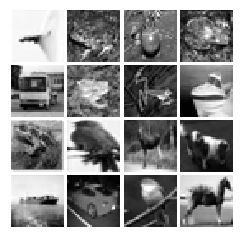

1.0
0.0


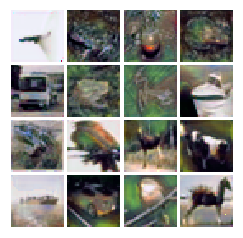

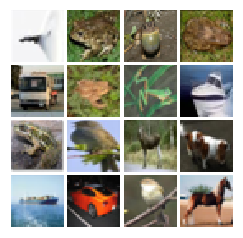

14


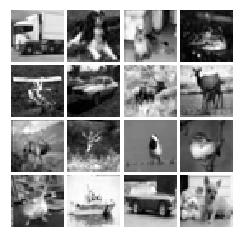

1.0
0.0


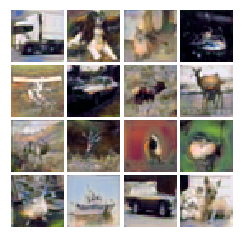

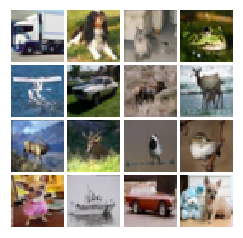

15


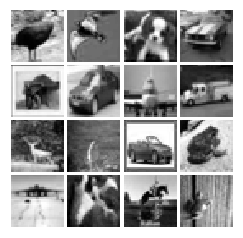

1.0
0.0


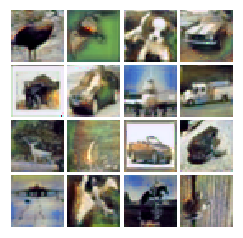

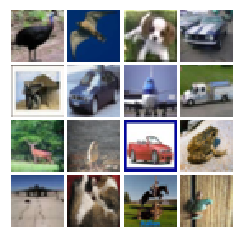

16


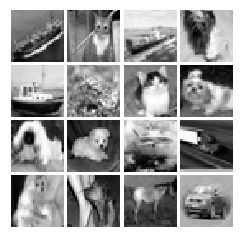

1.0
0.0


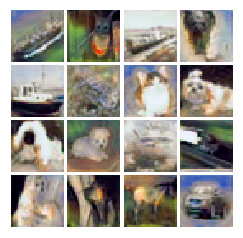

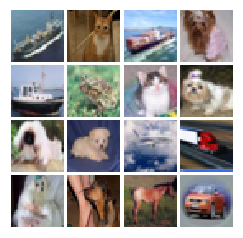

17


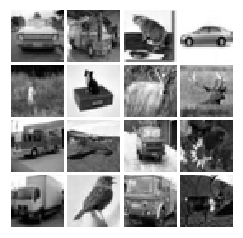

1.0
0.0


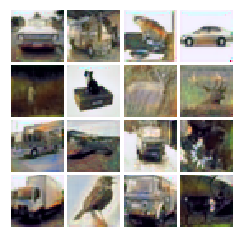

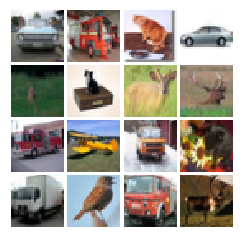

18


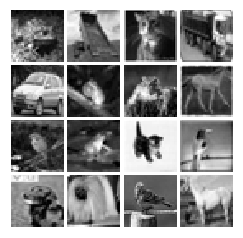

1.0
0.0


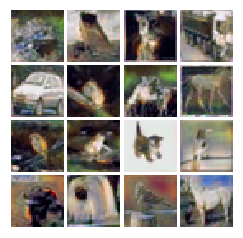

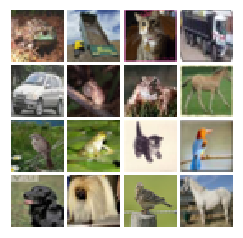

19


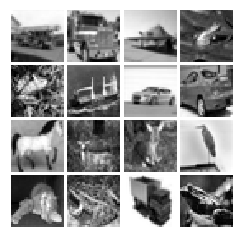

1.0
0.0


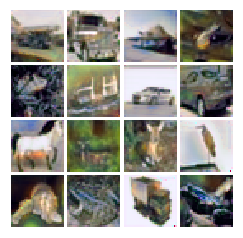

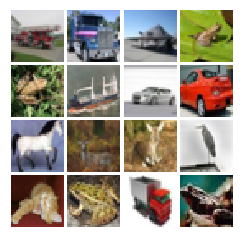

20


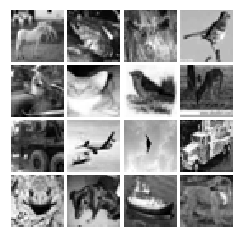

1.0
0.0


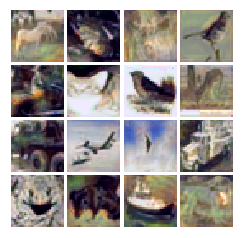

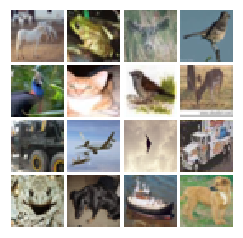

21


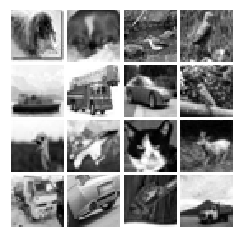

1.0
0.0


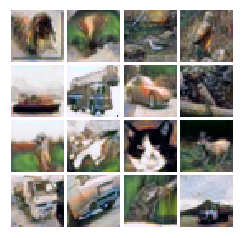

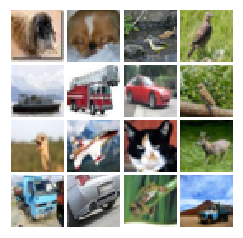

22


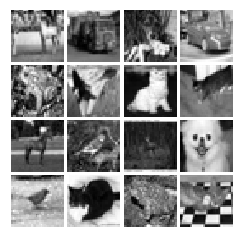

1.0
0.0


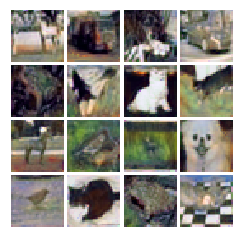

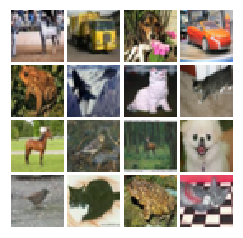

23


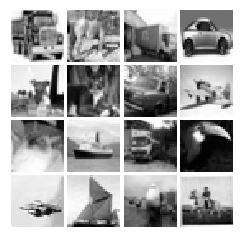

1.0
0.0


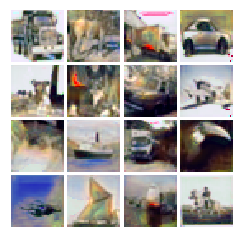

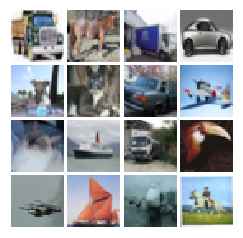

24


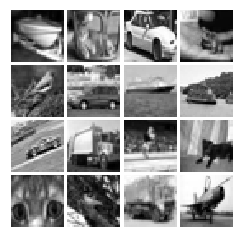

1.0
0.0


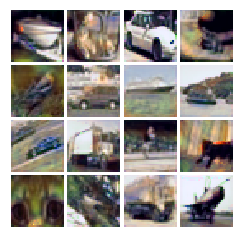

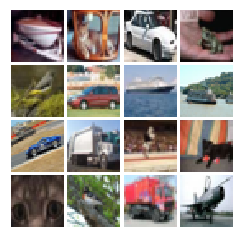

25


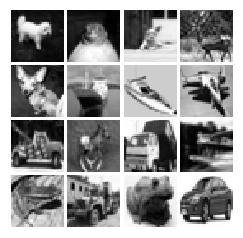

1.0
0.0


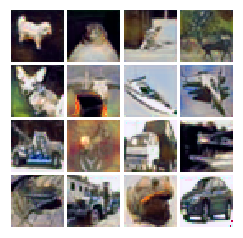

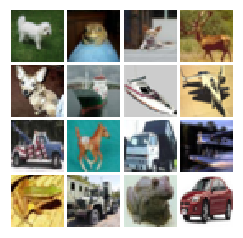

26


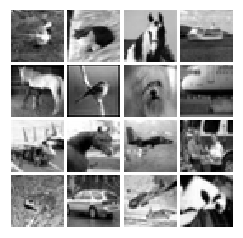

1.0
0.0


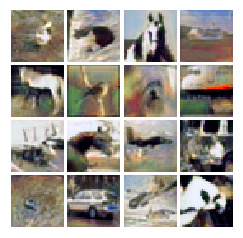

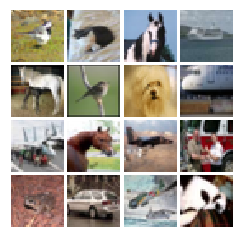

27


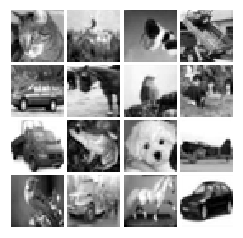

1.0
0.0


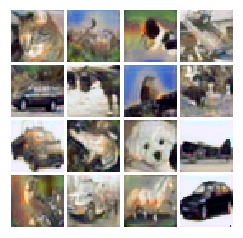

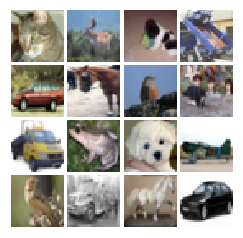

28


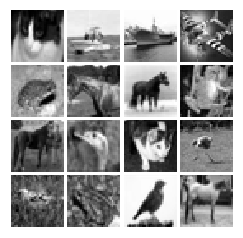

1.0
0.0


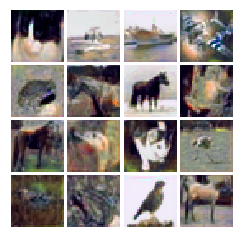

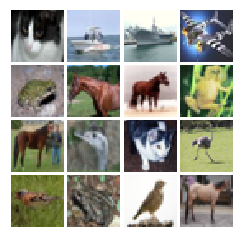

29


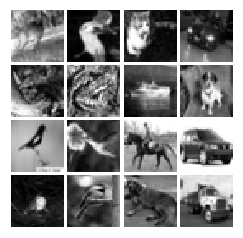

1.0
0.0


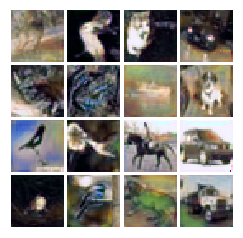

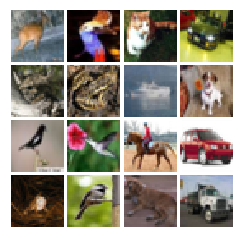

30


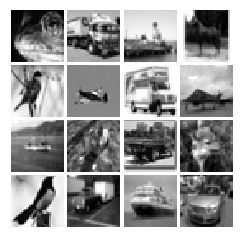

1.0
0.0


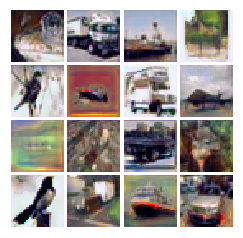

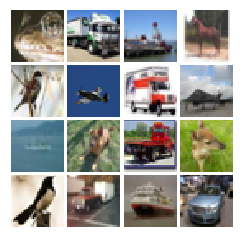

31


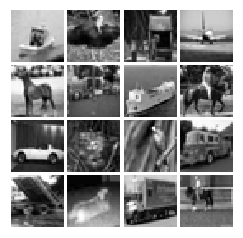

1.0
0.0


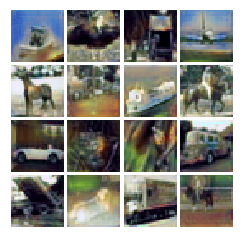

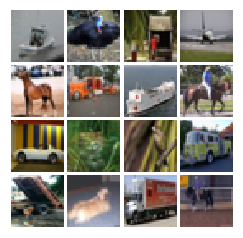

32


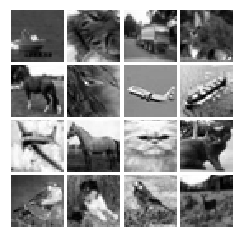

1.0
0.0


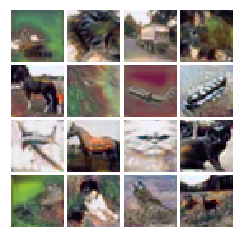

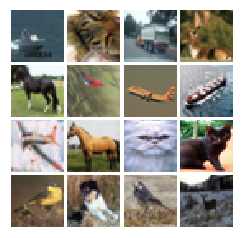

33


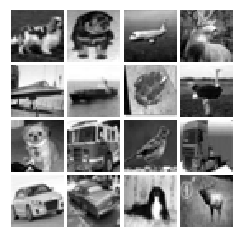

1.0
0.0


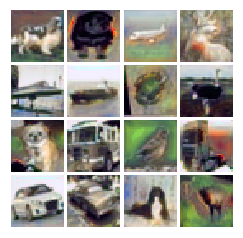

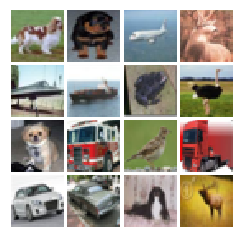

34


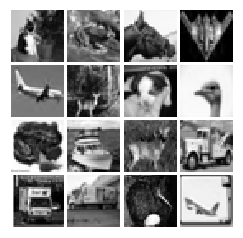

1.0
0.0


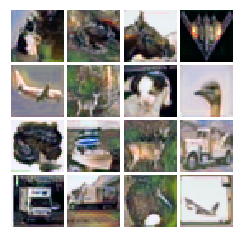

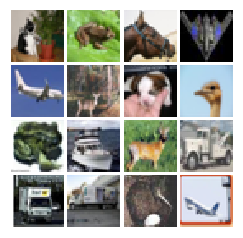

35


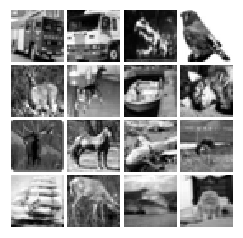

1.0
0.0


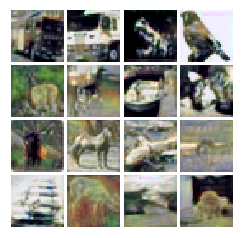

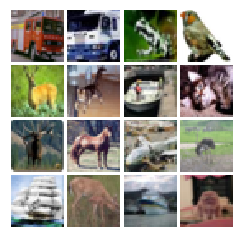

36


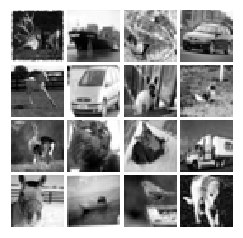

1.0
0.0


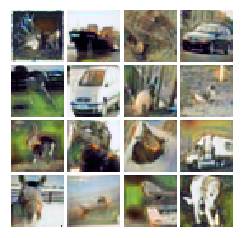

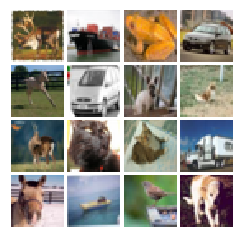

37


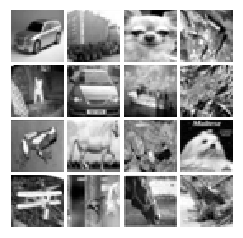

1.0
0.0


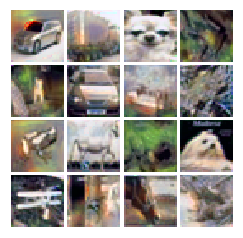

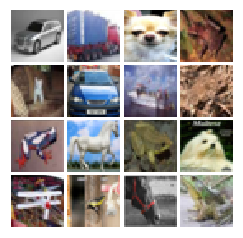

38


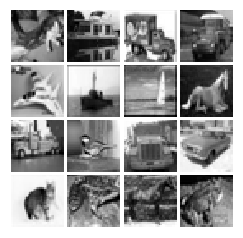

1.0
0.0


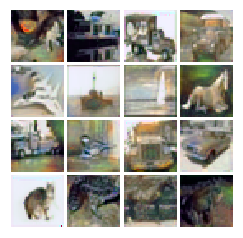

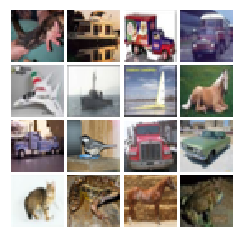

39


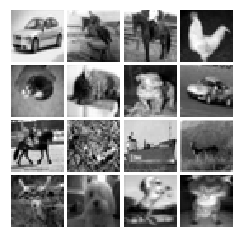

1.0
0.0


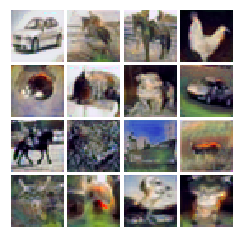

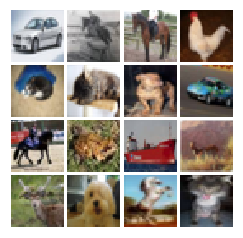

40


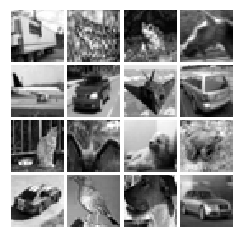

1.0
0.0


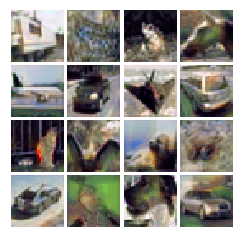

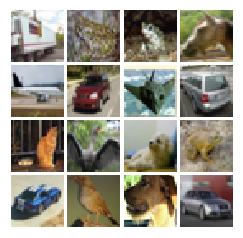

41


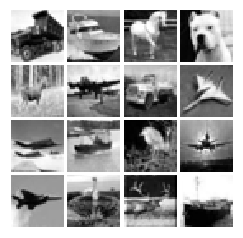

1.0
0.0


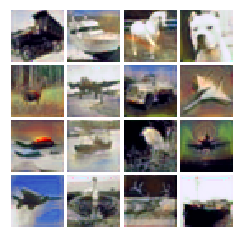

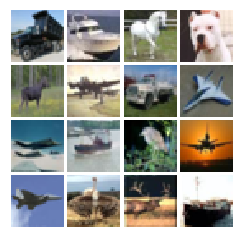

42


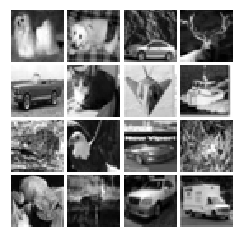

1.0
0.0


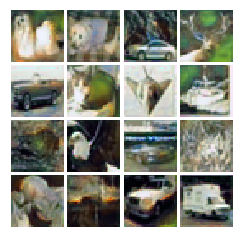

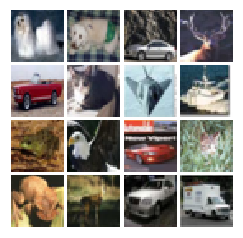

43


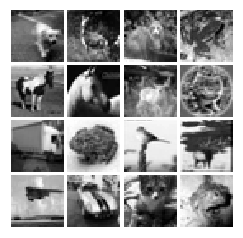

1.0
0.0


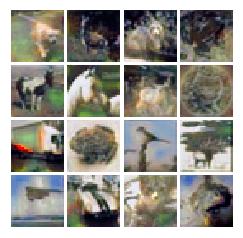

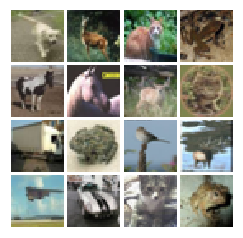

44


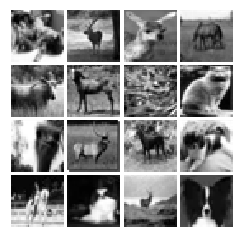

1.0
0.0


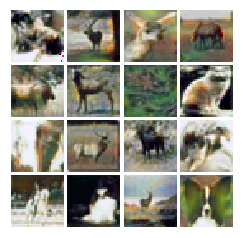

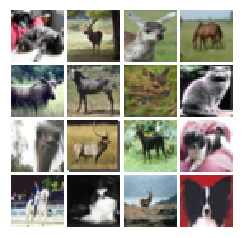

45


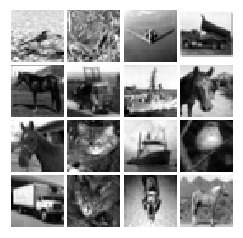

1.0
0.0


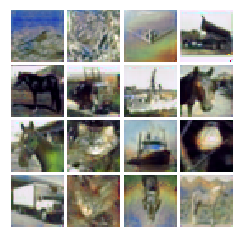

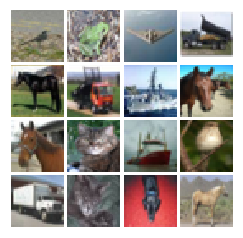

46


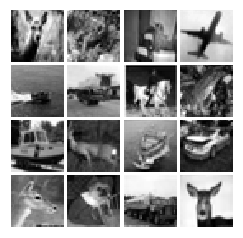

1.0
0.0


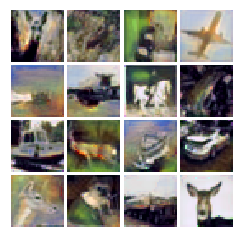

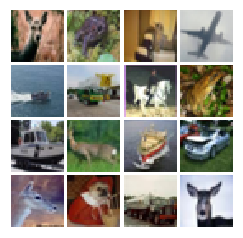

47


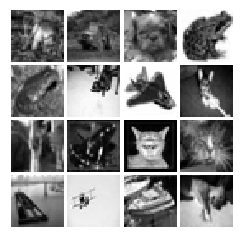

1.0
0.0


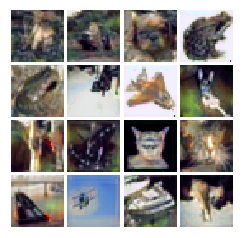

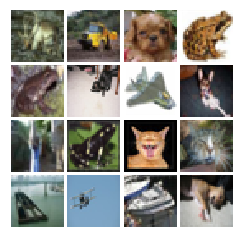

48


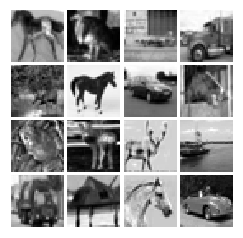

1.0
0.0


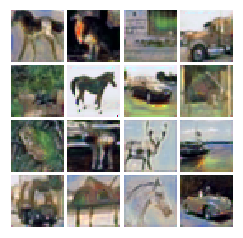

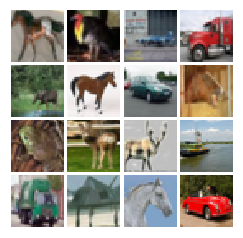

49


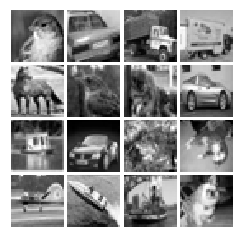

1.0
0.0


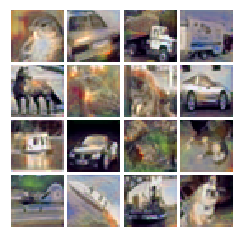

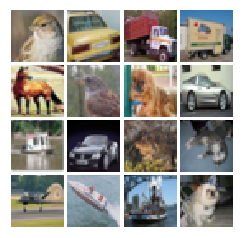

50


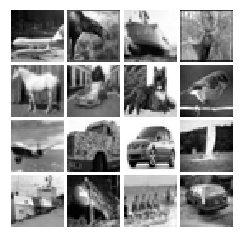

1.0
0.0


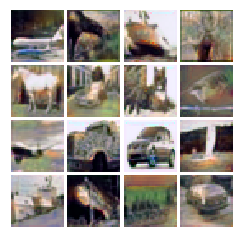

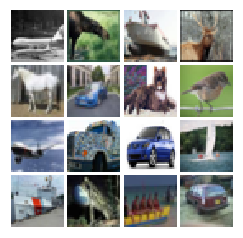

51


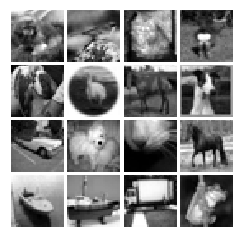

1.0
0.0


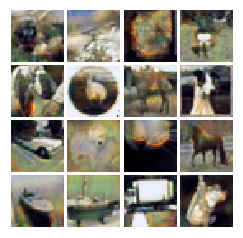

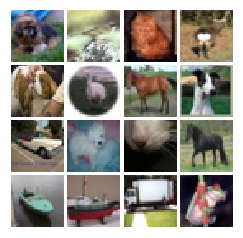

52


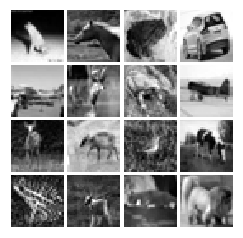

1.0
0.0


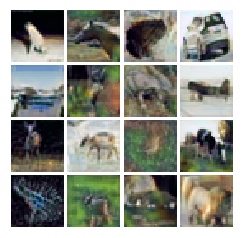

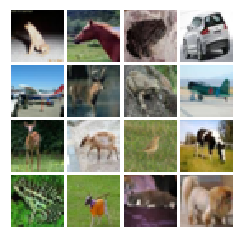

53


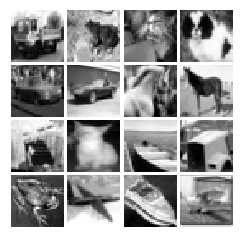

1.0
0.0


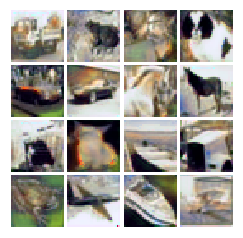

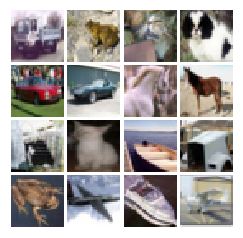

54


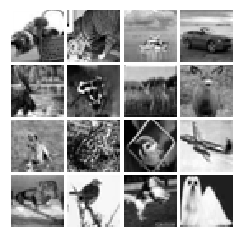

1.0
0.0


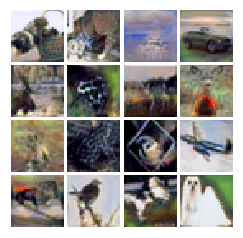

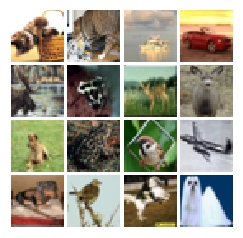

55


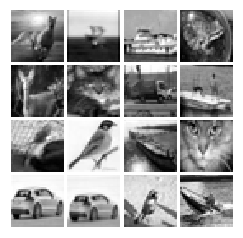

1.0
0.0


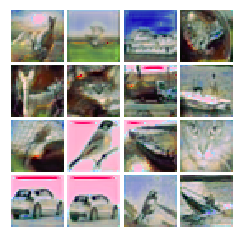

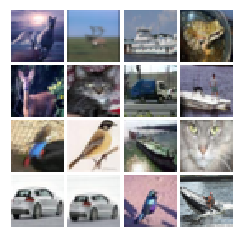

56


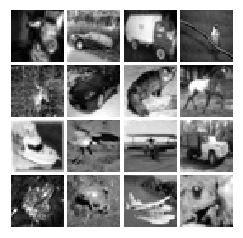

1.0
0.0


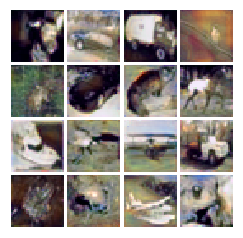

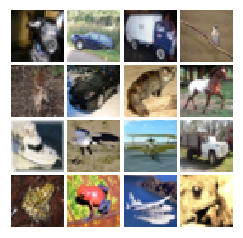

57


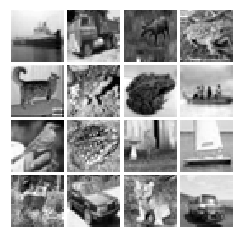

1.0
0.0


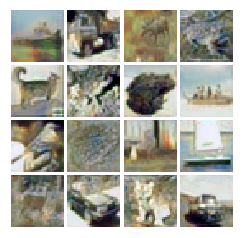

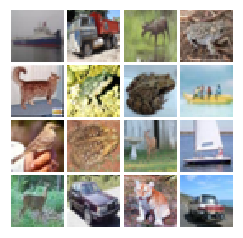

58


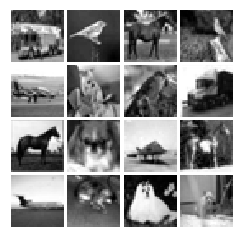

1.0
0.0


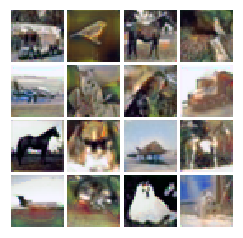

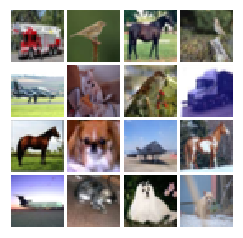

59


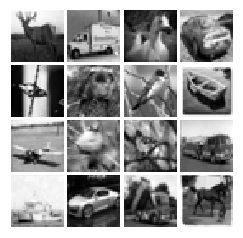

1.0
0.0


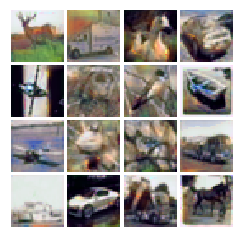

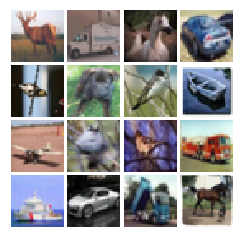

60


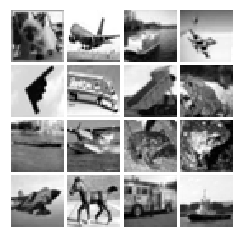

1.0
0.0


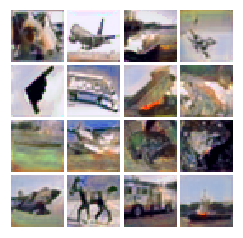

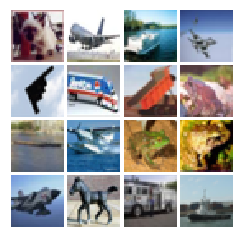

61


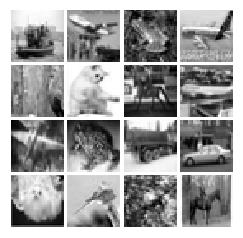

1.0
0.0


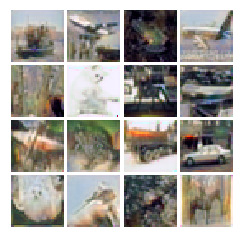

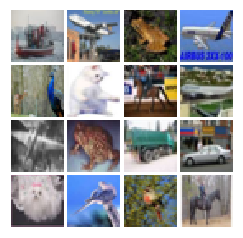

62


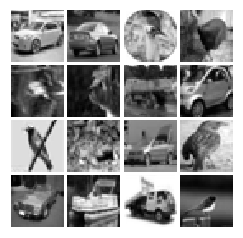

1.0
0.0


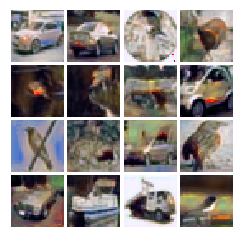

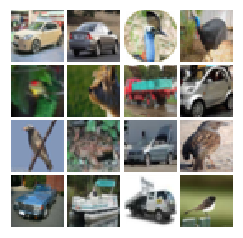

63


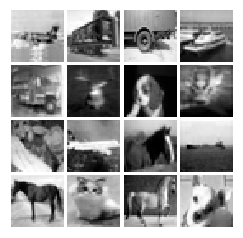

1.0
0.0


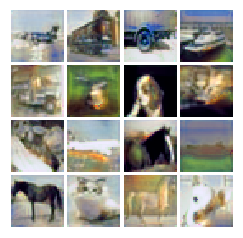

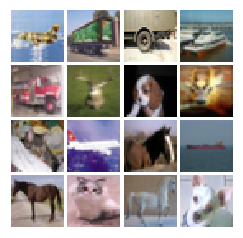

64


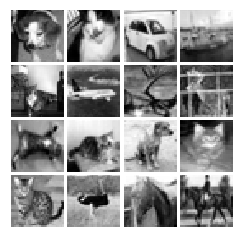

1.0
0.0


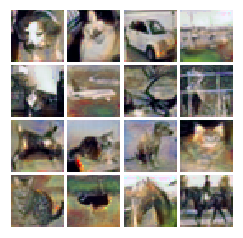

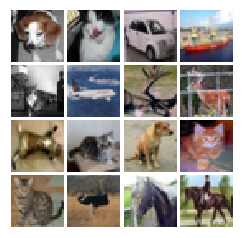

65


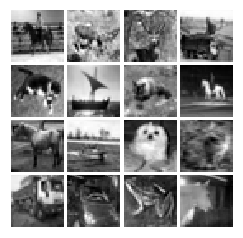

1.0
0.0


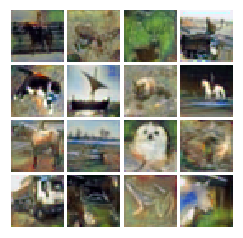

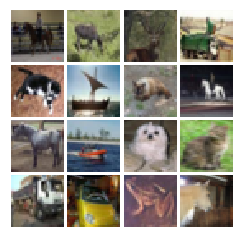

66


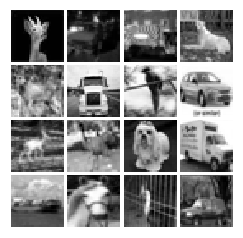

1.0
0.0


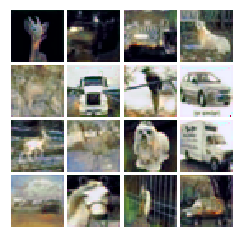

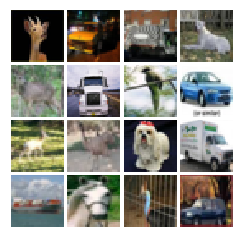

67


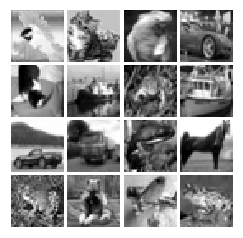

1.0
0.0


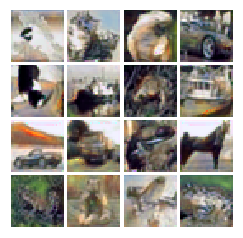

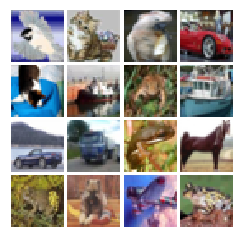

68


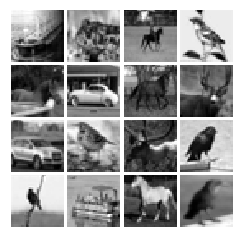

1.0
0.0


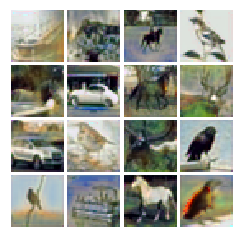

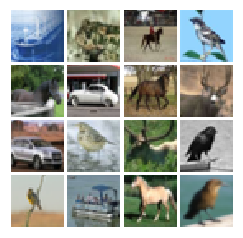

69


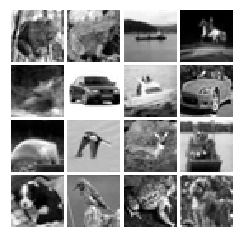

1.0
0.0


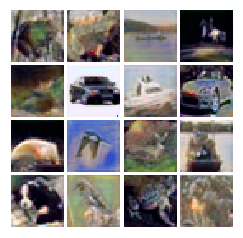

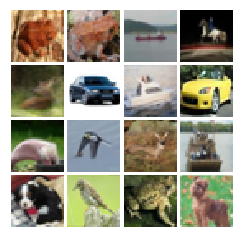

70


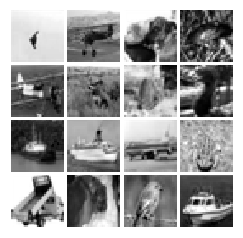

1.0
0.0


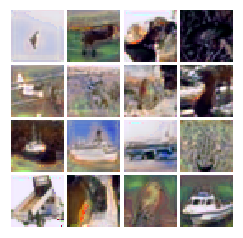

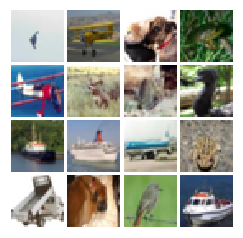

71


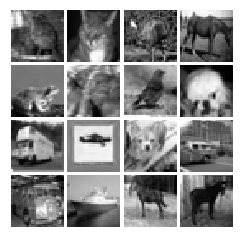

1.0
0.0


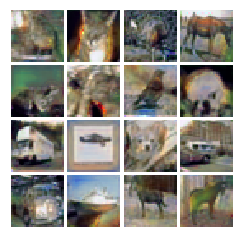

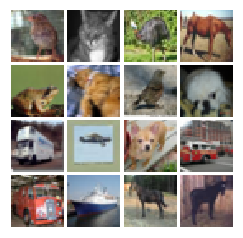

72


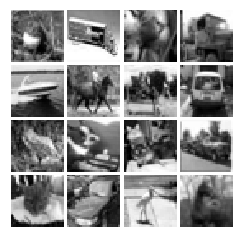

1.0
0.0


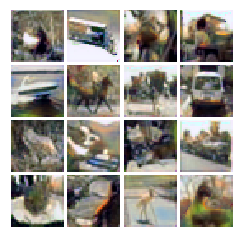

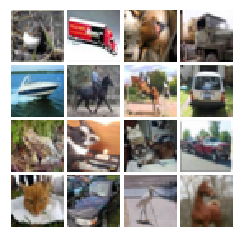

73


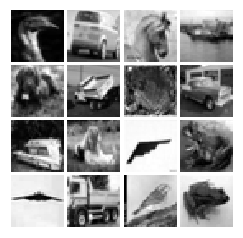

1.0
0.0


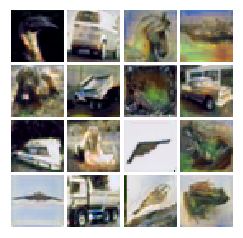

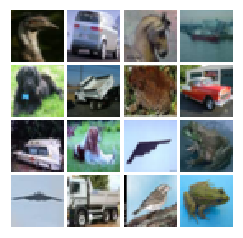

74


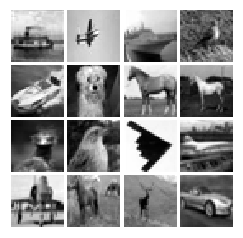

1.0
0.0


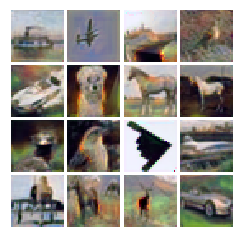

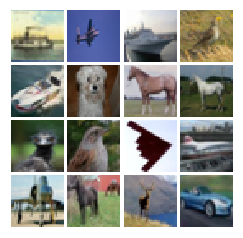

75


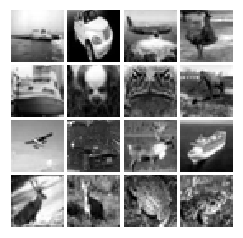

1.0
0.0


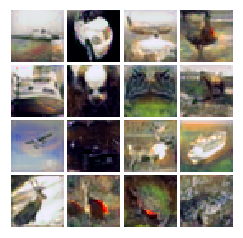

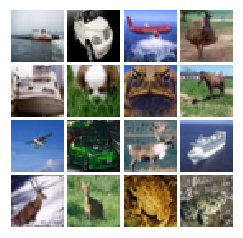

76


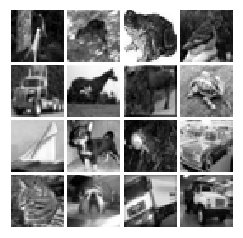

1.0
0.0


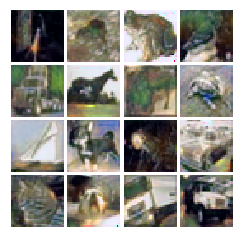

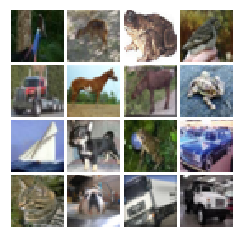

77


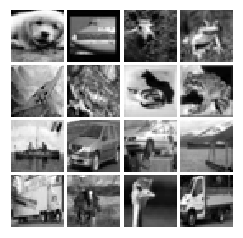

1.0
0.0


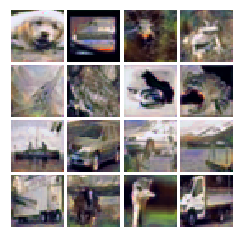

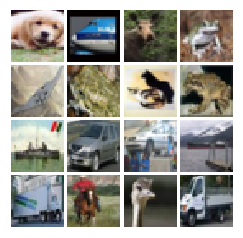

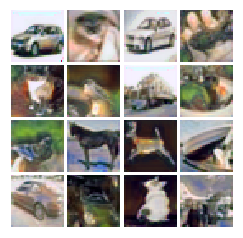

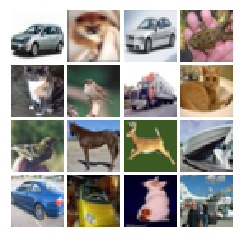

30670848
3072
0.97538475896


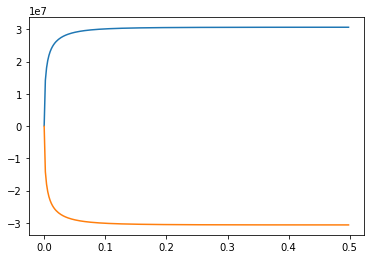

In [24]:
from Loss_metrics import AUC
X_test_sampled = X_test[:128*78,:,:,:]

X_test_model_gen = np.zeros([128*78,X_test.shape[1],X_test.shape[2],X_test.shape[3]])

for i in range(78):
    print (i)
    minibatch = X_test_sampled[i*128:(i+1)*128,:,:,:]
    samples_gray = sess.run(G_in,feed_dict = {x:minibatch})
    fig = show_images2(samples_gray[:16])
    plt.show()
    samples = sess.run(G_sample,feed_dict = {x:minibatch})
    samples[samples>1] = 1
    samples[samples<0]  =0 
    print (np.amax(samples))
    print (np.amin(samples))
    fig = show_images(samples[:16])
    plt.show()
    fig = show_images(minibatch[:16])
    plt.show()
    X_test_model_gen[i*128:(i+1)*128,:,:,:] = samples[:,:,:,:]
 


rgb_i = X_test_sampled
rgb_o = X_test_model_gen
rand_indices = np.random.choice(np.arange(128*78),batch_size)
minibatch = rgb_o[rand_indices]
fig = show_images(minibatch[:16])
plt.show()
minibatch = rgb_i[rand_indices]
fig = show_images(minibatch[:16])
plt.show()
print(rgb_i.size)
print(rgb_o[0].size)
auc, ans = AUC(np.reshape(rgb_i, [128*78, 32, 32, 3]), np.reshape(rgb_o, [128*78, 32, 32, 3]))
print(ans)

plt.plot(np.arange(0., 0.5, 0.5/256), auc)
plt.plot(np.arange(0., 0.5, 0.5/256), 1-auc)

In [25]:
def my_model(x,drop_o,is_training):
    
    W_conv = tf.get_variable("Wconv",shape = [7,7,3,32])
    b_conv = tf.get_variable("bconv",shape = [32])
    a1 = tf.nn.conv2d(x, W_conv, strides=[1,1,1,1], padding='SAME') + b_conv
    a1 = tf.contrib.layers.batch_norm(a1,center = True, scale = True, is_training = is_training,scope = 'bn1')
    a1 = tf.nn.relu(a1)
    a1 = tf.nn.max_pool(a1,ksize = [1,2,2,1],strides = [1,2,2,1],padding = 'VALID')
    
    W_conv2 = tf.get_variable("Wconv2",shape = [5,5,32,64])
    b_conv2 = tf.get_variable("bconv2",shape = [64])
    a1 = tf.nn.conv2d(a1, W_conv2, strides=[1,1,1,1], padding='SAME') + b_conv2
    a1 = tf.contrib.layers.batch_norm(a1,center = True, scale = True, is_training = is_training,scope = 'bn2')
    a1 = tf.nn.relu(a1)
    
    a1 = tf.nn.max_pool(a1,ksize = [1,2,2,1],strides = [1,2,2,1],padding = 'VALID')
    a1 = tf.nn.dropout(a1,drop_o)
   
    W_conv3 = tf.get_variable("Wconv3",shape = [3,3,64,96])
    b_conv3 = tf.get_variable("bconv3",shape = [96])
    a1 = tf.nn.conv2d(a1, W_conv3, strides=[1,1,1,1], padding='SAME') + b_conv3
    a1 = tf.contrib.layers.batch_norm(a1,center = True, scale = True, is_training = is_training,scope = 'bn3')
    a1 = tf.nn.relu(a1)
    a1 = tf.nn.dropout(a1,drop_o)
    #a1 = tf.nn.max_pool(a1,ksize = [1,2,2,1],strides = [1,2,2,1],padding = 'VALID')
    
    a1_flat = tf.reshape(a1,[-1,8*8*96])
    W1 = tf.get_variable("W1",shape = [8*8*96,1024])
    b1 = tf.get_variable("b1",shape = [1024])
    W2 = tf.get_variable("W2",shape = [1024,1024])
    b2 = tf.get_variable("b2",shape = [1024])
    W3 = tf.get_variable("W3",shape = [1024,10])
    b3 = tf.get_variable("b3",shape = [10])
    
    affine = tf.matmul(a1_flat,W1) + b1
    affine = tf.nn.relu(affine)
    affine = tf.nn.dropout(affine,drop_o)
    
    affine = tf.matmul(affine,W2) + b2
    affine = tf.nn.relu(affine)
    affine = tf.nn.dropout(affine,drop_o)
    
    y_out = tf.matmul(affine,W2) + b2
    return y_out

In [26]:
tf.reset_default_graph()

X = tf.placeholder(tf.float32, [None, 32, 32, 3])
y = tf.placeholder(tf.int64, [None])
is_training = tf.placeholder(tf.bool)
dropout = tf.placeholder(tf.float32, shape = ())

with tf.variable_scope("model") as scope:
    y_out = my_model(X,dropout,is_training)

mean_loss = None
optimizer = None

total_loss = tf.nn.sparse_softmax_cross_entropy_with_logits(logits = y_out,labels = y)
mean_loss = tf.reduce_mean(total_loss)

optimizer = tf.train.AdamOptimizer(1e-4)
extra_update_ops = tf.get_collection(tf.GraphKeys.UPDATE_OPS)
with tf.control_dependencies(extra_update_ops):
    train_step = optimizer.minimize(mean_loss)

In [27]:
yuv_converter = np.array([[0.299,0.587,0.114],[-0.14713,-0.2888,0.436],
                                  [0.615,-0.514999,-0.10001]])
inv_mat  = np.array([[1,0,1.13983],[1,-0.39465,-0.58060],[1,2.03211,0]])

sess = tf.Session()
saver = tf.train.Saver()
saver.restore(sess,'../models/cifar10_classification/classification_cifar10_model')

batch_size = 64
num_epochs = 78*2
num_correct = 0
num_total = 0
for i in range(num_epochs):
    X_test_samp = X_test_model_gen[i*64:(i+1)*64,:,:,:]
    
    #X_test_YUV = X_test_samp.dot(yuv_converter)
    #X_test_YUV[:,:,:,1:3] = 0
    
    #X_test_samp = X_test_YUV.dot(inv_mat)
    
    Y_test_samp = y_test[i*64:(i+1)*64]
    feed_dict ={X:X_test_samp,y:Y_test_samp,is_training:False,dropout:1}
    prediction = sess.run([y_out],feed_dict)
    
    y_pred = np.argmax(prediction[0],axis = 1)
    #print (y_pred.shape)
    #print()
    num_total += batch_size
    num_correct += sum(np.equal(y_pred, Y_test_samp))
print (num_correct/num_total)

INFO:tensorflow:Restoring parameters from ../models/cifar10_classification/classification_cifar10_model


INFO:tensorflow:Restoring parameters from ../models/cifar10_classification/classification_cifar10_model


0.638621794872


In [ ]:
#64.07 ab_out_images, 97.539
#62.69 l2_ab , 97.2006